# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams

import os
#import custom_functions as cf

In [2]:
import upsetplot as up

In [3]:
from datetime import date

today = date.today().strftime("%y%m%d")

Set parameters for plots in scanpy

In [4]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

# Analysis of snRNA-seq data from both young and old mice

## Data

In [5]:
project_dir = '/storage/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [6]:
data_dir = project_dir + 'data/'

Load the expression matrix from normal mice.

In [7]:
adata_normal = sc.read(data_dir + "normal/snRNAseq_mouse_hepatocytes_all_cells_apr20_raw.h5ad")

Load the expression matrix from knock_out mice.

In [8]:
adata_ko = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_ko_raw_jan21.h5ad')

Harmonize metadata before merging.

In [9]:
adata_normal.obs['exp.'].value_counts()

SNI-635        384
SNI-634        384
SNI-626        384
SNI-235(R2)    384
SNI-234(R2)    384
SNI-194        384
SNI-193        384
SNI-192-p2     384
SNI-192-p1     384
SNI-160(R2)    384
SNI-116(R2)    384
Name: exp., dtype: int64

In [10]:
adata_normal.obs = adata_normal.obs.drop(['Sample', 'Mapped', 'ERCC', 'Endogenous', 
                                          'Sort', 'Genome', 'ID.Individual', 'Tissue', 
                                          'TissueProcessing', 'Projects', 'AssayType', 
                                          'Protocol', 'Platform', 'ERCC.Vol..in.RT.Vol.',
                                          'ERCC.Lot.number', 'Seq_Tube_ID', 'Seq.Type',
                                          'Sequencer', 'Nextera.XT...384.CDIs','Index.i5',
                                          'Index.i7','LPP.Frag..Size..bp.','Submitted.Conc...nM.',
                                          'Submitted.Vol...ul.', 'LIMS'
                                         ], axis=1)

In [11]:
adata_normal.obs_keys()

['batch',
 'exp.',
 'LibraryID',
 'Experiment',
 'Strain',
 'Age',
 'Sex',
 'Ploidy',
 'ERCC.dilution',
 'column',
 'row',
 'percentERCC\n']

In [12]:
adata_ko.obs = adata_ko.obs.drop([ 'batch', 'plate', 'Specie/strain', 'mice ID', 
                                  'Solexa', 'CM number', 'HiSeq', 'PE',  'indexes',
                                  'indexes.1', 'index', 'index.1', 'index.2', 'index.3',
                                  'DO number', 'log_counts','n_genes','n_counts_transcripts',
 'n_counts_ERCC', 'LIMS'
                                         ], axis=1)

Notes: 
- Rename Strain to strain.
- rename Age to age
- Rename categories in 'ERCC.dilution'
- Rename 'percentERCC\n' to 'percentERCC'
- Rename Experiment to experiment
- Rename Sex to sex
- Rename LibraryID to libraryID

In KO:
- Rename raw to row
- Create column and row info correctly (check where '820' has gone to in column)
- rename condtition to ploidy
- rename code to experiment
- duplicate code as libraryID

In [16]:
adata_normal.obs = adata_normal.obs.rename(columns={"Age": "age", "Strain": "strain", "Ploidy": "ploidy",
                                                    "percentERCC\n": "percentERCC", "Sex": 'sex', 
                                                    "Experiment": "experiment", "LibraryID": "libraryID"
                                                   })
adata_normal.obs['ERCC.dilution'] = adata_normal.obs['ERCC.dilution'].cat.rename_categories({"1 in 100.000" : "1:100.000",
                                                                                             "1 in 300.000" : "1:300.000",
                                                                                            })

In [14]:
adata_ko.obs = adata_ko.obs.rename(columns={'raw': 'row', 'condtition': 'ploidy', "code": "experiment"})
adata_ko.obs['libraryID'] = adata_ko.obs['experiment']

In [15]:
adata_normal.obs['column'].value_counts()

15     184
13     176
12     176
2      176
3      176
4      176
5      176
6      176
7      176
8      176
9      176
10     176
11     176
1      176
24     176
16     176
17     176
18     176
19     176
21     176
22     176
23     176
20     173
14     168
820      3
Name: column, dtype: int64

First, check the experiment IDs for the column 15, because there might be 8 too many, which are missing in column 14.

Extract `column` info from `experiment` code.

In [17]:
meta_pos = [pos.split('-')[-2] for pos in adata_normal.obs['experiment']]

In [18]:
adata_normal.obs['column'] = pd.Series(meta_pos, index=adata_normal.obs_names, dtype='category')

In [19]:
adata_normal.obs['column'].value_counts()

9      176
2      176
10     176
11     176
12     176
13     176
14     176
15     176
16     176
17     176
18     176
19     176
1      176
21     176
22     176
23     176
24     176
3      176
4      176
5      176
6      176
7      176
8      176
20     165
820     11
Name: column, dtype: int64

The '820' belong to plate position `20 L`. Let us rename the column values accordingly in normal.

In [20]:
adata_normal.obs['column'].loc[adata_normal.obs['column']=='820'] = '20'
adata_normal.obs['column'] = adata_normal.obs['column'].cat.remove_unused_categories()

In [21]:
adata_normal.obs['column'].value_counts()

9     176
8     176
10    176
11    176
12    176
13    176
14    176
15    176
16    176
17    176
18    176
19    176
2     176
20    176
21    176
22    176
23    176
24    176
3     176
4     176
5     176
6     176
7     176
1     176
Name: column, dtype: int64

A similar problem with the correct column assignment happened in the KO samples.

In [22]:
adata_ko.obs['column'].value_counts()

15    221
23    208
17    208
8     208
12    208
16    208
20    208
24    208
1     208
5     208
9     208
13    208
21    208
19    208
2     208
6     208
10    208
18    208
22    208
3     208
7     208
11    208
4     208
14    195
Name: column, dtype: int64

In [23]:
adata_ko.obs.loc[np.in1d(adata_ko.obs['column'], 15)].head()

,n_counts,exp.,ploidy,age,experiment,column,row,strain,ERCC.dilution,percentERCC,libraryID
do21654,488432.0,SNI-196,4n,21 mo,CM-SNI-196-14-P,15,P,CTCF KO,1:100.000,0.523969,CM-SNI-196-14-P
do21655,503814.0,SNI-196,2n,4 mo,CM-SNI-196-15-A,15,A,CTCF KO,1:100.000,0.564371,CM-SNI-196-15-A
do21656,453573.0,SNI-196,2n,4 mo,CM-SNI-196-15-B,15,B,CTCF KO,1:100.000,0.632099,CM-SNI-196-15-B
do21657,338762.0,SNI-196,2n,4 mo,CM-SNI-196-15-C,15,C,CTCF KO,1:100.000,0.950012,CM-SNI-196-15-C
do21658,403696.0,SNI-196,2n,4 mo,CM-SNI-196-15-D,15,D,CTCF KO,1:100.000,0.623833,CM-SNI-196-15-D


Extract `column` info from `experiment` code.

In [24]:
meta_pos = [pos.split('-')[-2] for pos in adata_ko.obs['experiment']]
meta_pos = pd.Series(meta_pos, index=adata_ko.obs_names, dtype='category')

In [25]:
adata_ko.obs['column'] = adata_ko.obs['column'].astype('category')

In [26]:
adata_ko.obs.loc[np.in1d(adata_ko.obs['column'], 15)].head()

,n_counts,exp.,ploidy,age,experiment,column,row,strain,ERCC.dilution,percentERCC,libraryID
do21654,488432.0,SNI-196,4n,21 mo,CM-SNI-196-14-P,15,P,CTCF KO,1:100.000,0.523969,CM-SNI-196-14-P
do21655,503814.0,SNI-196,2n,4 mo,CM-SNI-196-15-A,15,A,CTCF KO,1:100.000,0.564371,CM-SNI-196-15-A
do21656,453573.0,SNI-196,2n,4 mo,CM-SNI-196-15-B,15,B,CTCF KO,1:100.000,0.632099,CM-SNI-196-15-B
do21657,338762.0,SNI-196,2n,4 mo,CM-SNI-196-15-C,15,C,CTCF KO,1:100.000,0.950012,CM-SNI-196-15-C
do21658,403696.0,SNI-196,2n,4 mo,CM-SNI-196-15-D,15,D,CTCF KO,1:100.000,0.623833,CM-SNI-196-15-D


In [27]:
adata_ko.obs['column'] = meta_pos

In [28]:
adata_ko.obs['column'].value_counts()

9      208
2      208
10     208
11     208
12     208
13     208
14     208
15     208
16     208
17     208
18     208
19     208
1      208
21     208
22     208
23     208
24     208
3      208
4      208
5      208
6      208
7      208
8      208
20     195
820     13
Name: column, dtype: int64

In [29]:
adata_ko.obs_names[np.logical_and(adata_ko.obs['column']=='820', adata_ko.obs['row']=='L')]

Index(['do21746', 'do23776', 'do26080', 'ID-SNI-621-820-L', 'ID-SNI-630-820-L',
       'ID-SNI-631-820-L', 'do21362', 'ID-SNI-651-820-L', 'ID-SNI-652-820-L',
       'ID-SNI-653-820-L', 'ID-SNI-664-820-L', 'ID-SNI-665-820-L',
       'ID-SNI-667-820-L'],
      dtype='object')

In [30]:
adata_ko.obs['column'].loc[adata_ko.obs['column']=='820'] = '20'
adata_ko.obs['column'] = adata_ko.obs['column'].cat.remove_unused_categories()

Merge both `anndata` files.

In [31]:
adata = adata_normal.concatenate(
    adata_ko, 
    batch_key = 'batch', 
    index_unique=None
).copy()

In [32]:
adata.obs_keys()

['batch',
 'exp.',
 'libraryID',
 'experiment',
 'strain',
 'age',
 'sex',
 'ploidy',
 'ERCC.dilution',
 'column',
 'row',
 'percentERCC',
 'n_counts']

Distribute cells into age groups. The data consists of different age groups (e.g. 3 months, 22 months and 22.5 months). I consider the latter two as "old" and the first one as "young".

In [33]:
adata.obs['age'].value_counts()

3 months       2496
22.3mo         1344
3.5mo          1344
22 months      1152
22.5 months     576
3 mo            576
21mo            384
3mo             384
23 mo           384
21 mo           384
4 mo            192
Name: age, dtype: int64

In [34]:
adata.obs['age'] = adata.obs['age'].astype('category')
adata.obs['age_grouped'] = adata.obs['age'].cat.add_categories(['young', 'old'])
adata.obs['age_grouped'][np.in1d(adata.obs['age'], 
                                 ['3 months', '3 mo','3mo', '3.5mo', '4 mo'])] = 'young'
adata.obs['age_grouped'][np.in1d(adata.obs['age'], 
                                 ['21mo','21 mo', '22.3mo', '23 mo', '22 months', '22.5 months'])] = 'old'
adata.obs['age_grouped'] = adata.obs['age_grouped'].cat.remove_unused_categories()

In [35]:
adata.obs['age_grouped'].value_counts()

young    4992
old      4224
Name: age_grouped, dtype: int64

Manually adding the raw counts of some sparsely expressed marker genes

In [36]:
# split ERCC counts into a different object
ERCC = []
for i in adata.var_names:
    if i[0:3] != "ENS" and i[0:2] != "__":
        ERCC.append(i)
        
adataERCC = adata[:,ERCC].copy()

In [37]:
# split endogenous transcript counts into a different object
transc = []
for i in adata.var_names:
    if i[0:3] == "ENS":
        transc.append(i)

adataT = adata[:,transc].copy()

Removing additional output from htseq-count

In [38]:
# remove the additional output from htseq-count from the matrix
amb = []
for i in adata.var_names:
    if i[0:2] != "__":
        amb.append(i)
        
adata = adata[:,amb].copy()

In [39]:
adata.obs['n_counts_raw'] = adata.X.sum(axis=1) # endogeneous transcripts + ERCCs
adata.obs["n_counts_transcripts"] = np.sum(adataT.X, axis=1) # endogenous transcripts only
adata.obs["n_counts_ERCC"] = np.sum(adataERCC.X, axis=1) # ERCCs only
adata.obs["percentERCC"] = pd.to_numeric(adata.obs["percentERCC"]) # make percent ERCC column numeric

Save to file.

In [39]:
adata.write(data_dir + 'snRNAseq_normal_KO_concatenated_jan21.h5ad')

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'sex' as categorical
... storing 'ploidy' as categorical


In [40]:
adata

AnnData object with n_obs × n_vars = 9216 × 54324
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'Krt14', 'Krt19', 'Krt7', 'Krt9', 'Prom1', 'Dlk1', 'Erbb2', 'Mki67', 'Oct4', 'Cd34', 'Tpm2', 'Ace2', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end'

In [7]:
adata = sc.read(data_dir + 'snRNAseq_normal_KO_concatenated_jan21.h5ad')

## Cutoff visualization

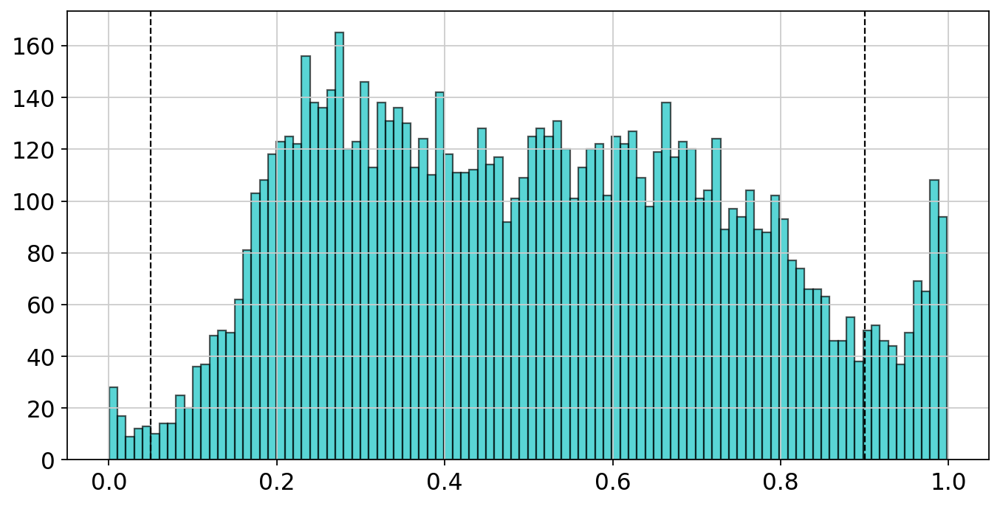

In [40]:
rcParams['figure.figsize']=(10,5)
# visualize cutoffs for filtering cells based on their percentage of ERCC reads
p = plt.hist(adata.obs["percentERCC"], bins=100, color='c', edgecolor='k', alpha=0.65)
plt.axvline(0.9, color='k', linestyle='dashed', linewidth=1)
plt.axvline(0.05, color='k', linestyle='dashed', linewidth=1)
plt.show()

In [41]:
# remove cells that have no genes expressed
sc.pp.filter_cells(adata, min_genes=1)
sc.pp.filter_cells(adata, min_counts=1)

In [42]:
adata

AnnData object with n_obs × n_vars = 9216 × 54324
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end'

In [12]:
adata.obs['exp.'].value_counts().to_csv(data_dir + 'cell_number_before_QC.csv')

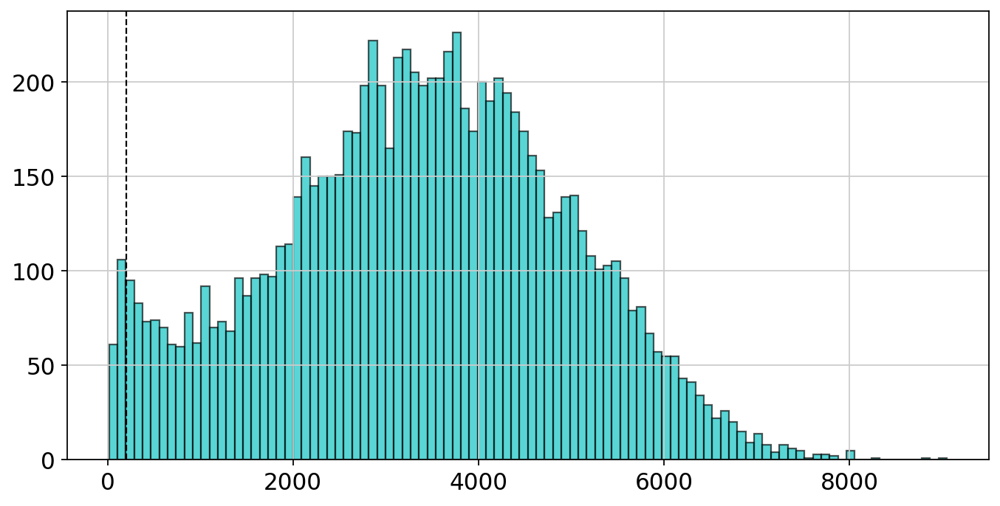

In [43]:
# visualize lower cutoff for filtering cells based on the number of genes
p = plt.hist(adata.obs["n_genes"], bins=100, color='c', edgecolor='k', alpha=0.65)
plt.axvline(200, color='k', linestyle='dashed', linewidth=1)
plt.show()

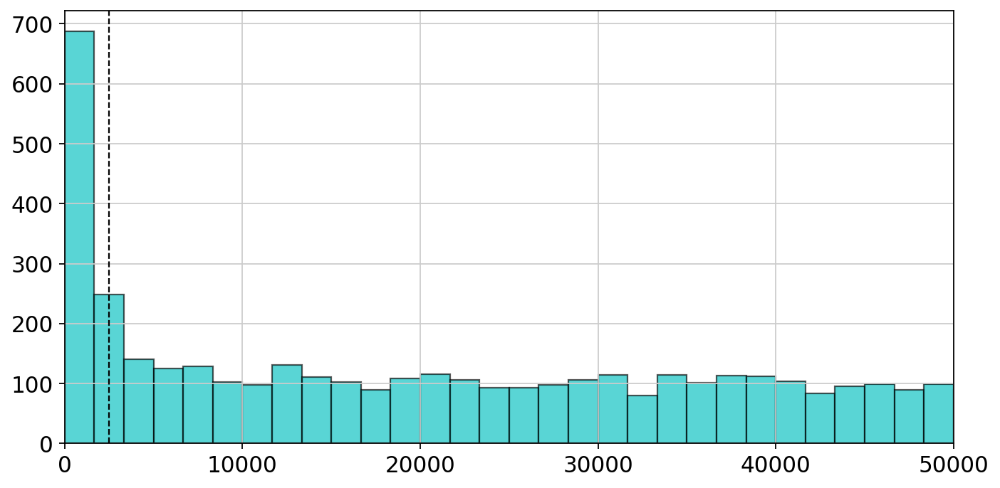

In [118]:
# visualize lower cutoff for filtering cells based on the number of genes
p = plt.hist(adata.obs["n_counts_transcripts"], bins=800, color='c', edgecolor='k', alpha=0.65)
plt.axvline(2500, color='k', linestyle='dashed', linewidth=1)
plt.axvline(300000, color='k', linestyle='dashed', linewidth=1)
plt.xlim([0, 5e4])
plt.show()

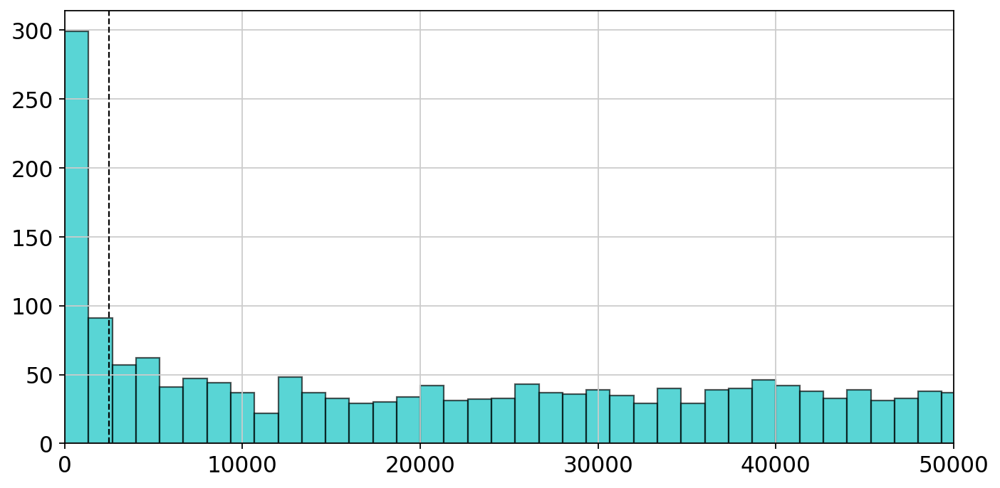

In [122]:
# visualize lower cutoff for filtering cells based on the number of genes
p = plt.hist(adata.obs["n_counts_transcripts"][adata.obs['age_grouped']=='old'], 
             bins=1000, color='c', edgecolor='k', alpha=0.65)
plt.axvline(2500, color='k', linestyle='dashed', linewidth=1)
plt.axvline(300000, color='k', linestyle='dashed', linewidth=1)
plt.xlim([0, 5e4])
plt.show()

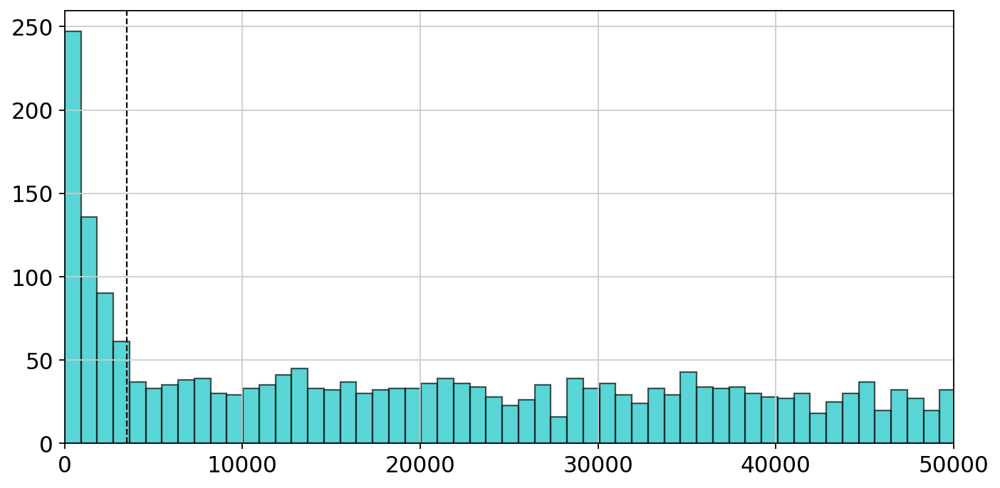

In [125]:
# visualize lower cutoff for filtering cells based on the number of genes
p = plt.hist(adata.obs["n_counts_transcripts"][adata.obs['age_grouped']=='young'], 
             bins=800, color='c', edgecolor='k', alpha=0.65)
plt.axvline(3500, color='k', linestyle='dashed', linewidth=1)
plt.axvline(300000, color='k', linestyle='dashed', linewidth=1)
plt.xlim([0, 5e4])
plt.show()

### Filtering

We will distinguish between old and young cells for the filtering, because old cells have been shown to have a lower mRNA content in general. 

Keeping nuclei with 5-90% ERCC reads and a minimum of 200 genes expressed  
Keeping genes that are present with at least 50 overall reads across cells

In [46]:
adata.obs['high_ERCC'] = adata.obs["percentERCC"] > 0.9
adata.obs['low_ERCC'] = adata.obs["percentERCC"] <= 0.05

In [106]:
adata.obs['low_genes'] = adata.obs['n_genes']<200
adata.obs['high_genes'] = adata.obs['n_genes']>=7000
adata.obs['low_counts'] = adata.obs['n_counts_transcripts'] <= 2000
adata.obs['high_counts'] = adata.obs['n_counts_transcripts'] >= 300000

In [107]:
df_filter = adata.obs[['high_ERCC', 'low_ERCC', 'low_genes', 
                       'high_genes', 'low_counts', 'high_counts']]

In [108]:
low_qual_id = df_filter.sum(1)>0

df_filter = df_filter[low_qual_id]

In [109]:
low_qual_id.sum()

1556

In [110]:
df_filter.head()

,high_ERCC,low_ERCC,low_genes,high_genes,low_counts,high_counts
do20280,True,False,False,False,False,False
do20281,True,False,False,False,False,False
do20286,True,False,False,False,False,False
do20289,True,False,False,False,False,False
do20291,True,False,False,False,False,False


In [111]:
df_filter['c'] = '1'

In [112]:
df_test = df_filter.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                   'high_genes','low_counts', 'high_counts']).count().sort_values('c')

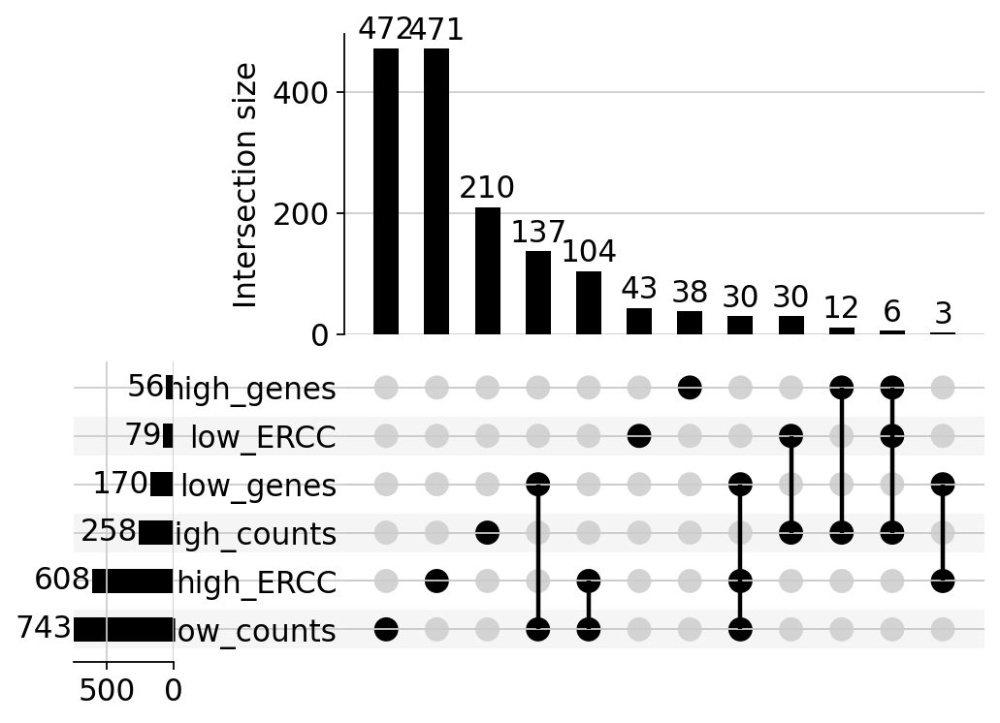

In [113]:
rcParams['figure.figsize']=(10,5)
up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
plt.savefig('./figures/'+today+ '_lenient_filtering_all.pdf',bbox_inches='tight')
plt.show()

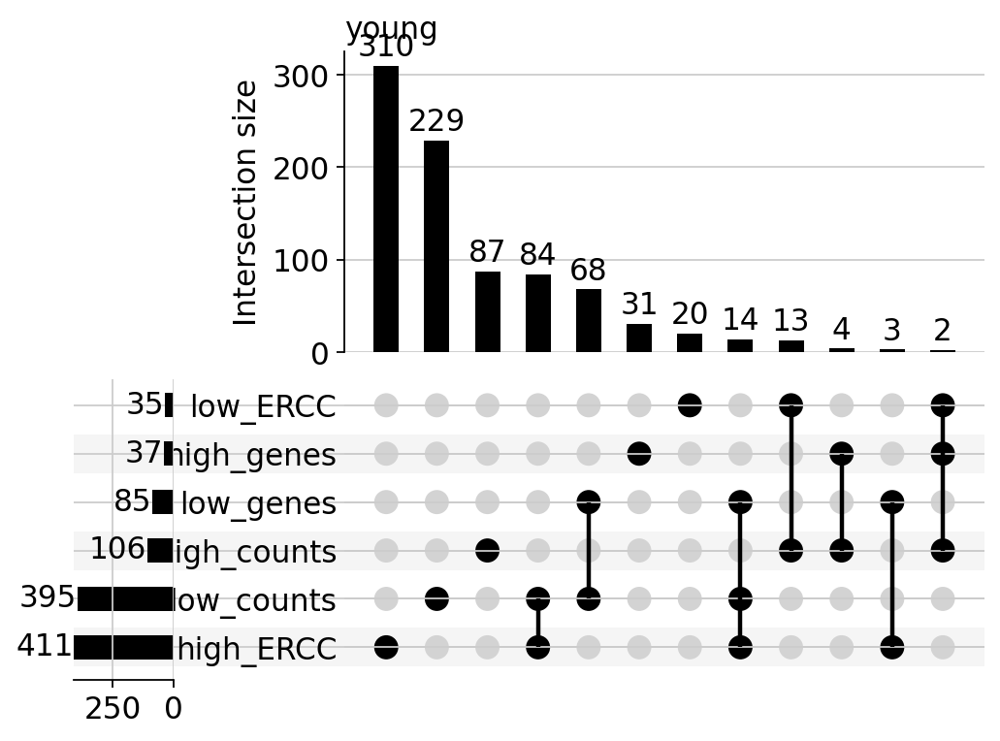

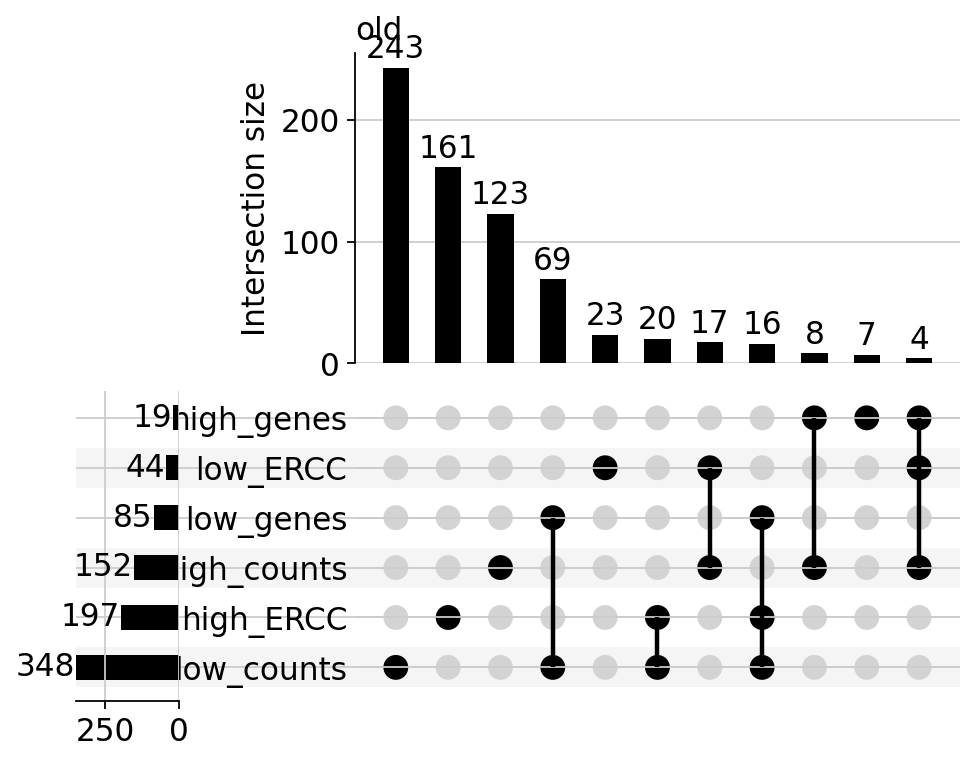

In [114]:
for age in adata.obs['age_grouped'].cat.categories:
    age_id = adata.obs['age_grouped'] == age
    age_names = adata.obs_names[age_id]
        
    df_filter_tmp = df_filter[np.in1d(df_filter.index, age_names)]
    df_test = df_filter_tmp.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')
    up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
    plt.title( age, loc='left')
    plt.savefig('./figures/'+today+ '_lenient_filtering_'+ age +'.pdf',bbox_inches='tight')
    plt.show()

In [88]:
adata.obs['exp.'] = adata.obs['exp.'].astype('category')

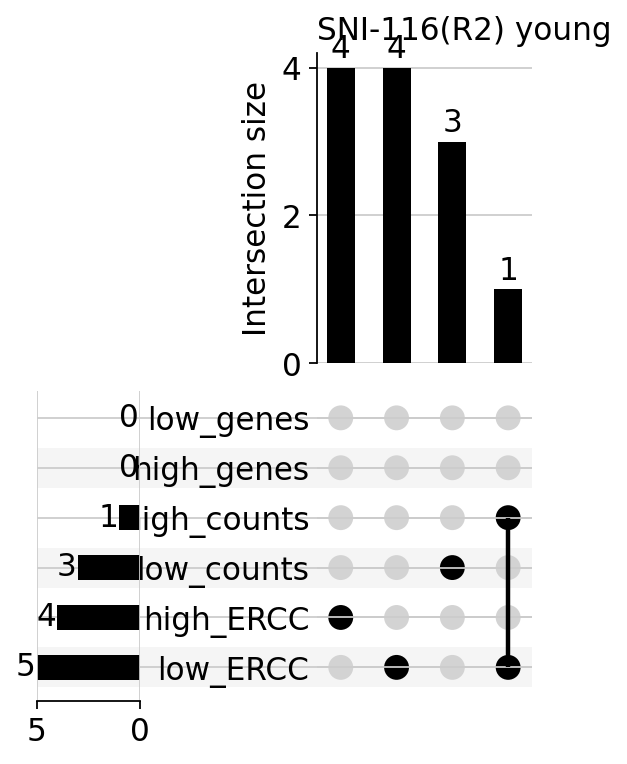

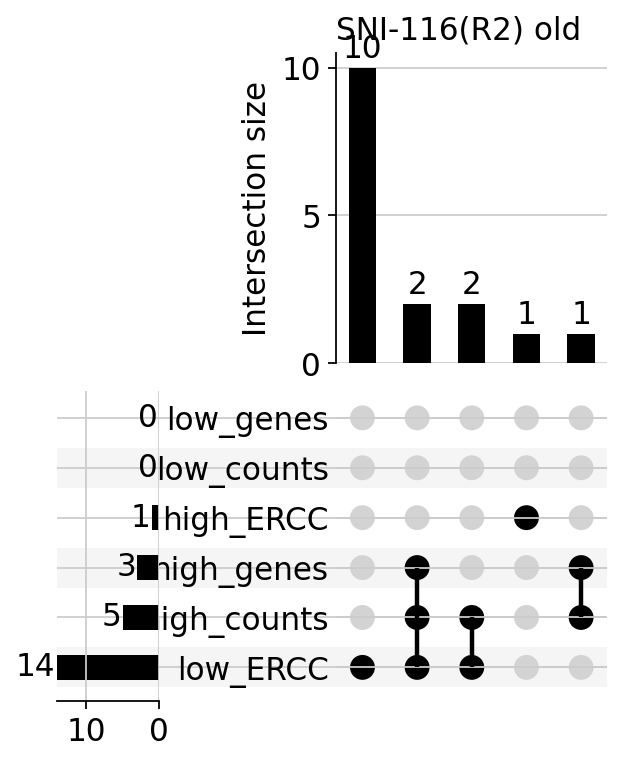

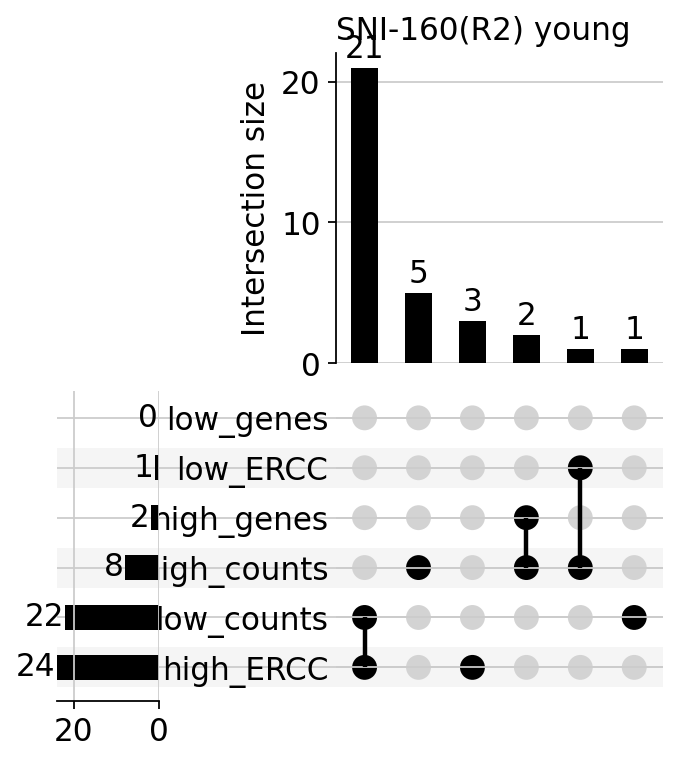

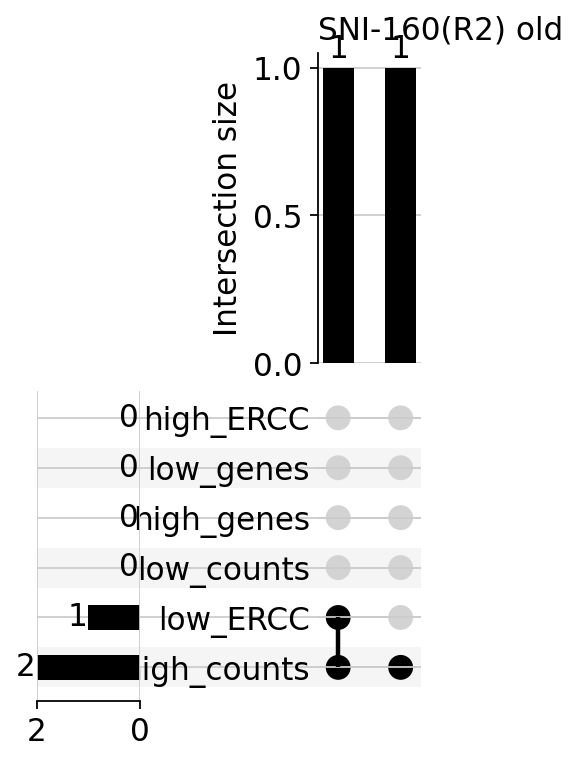

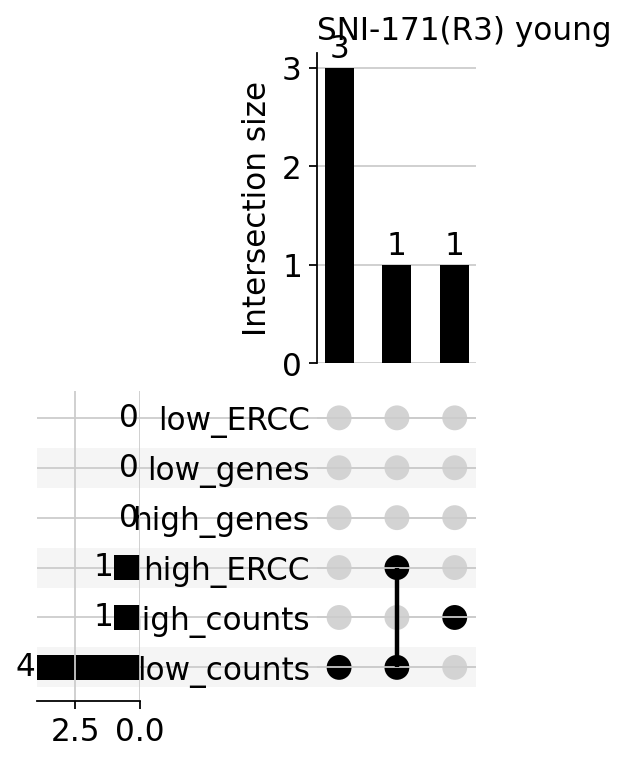

...

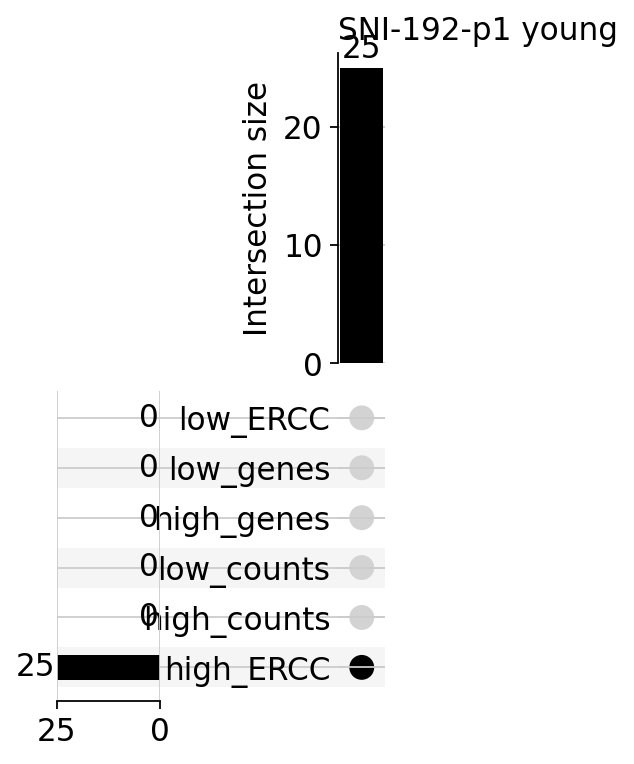

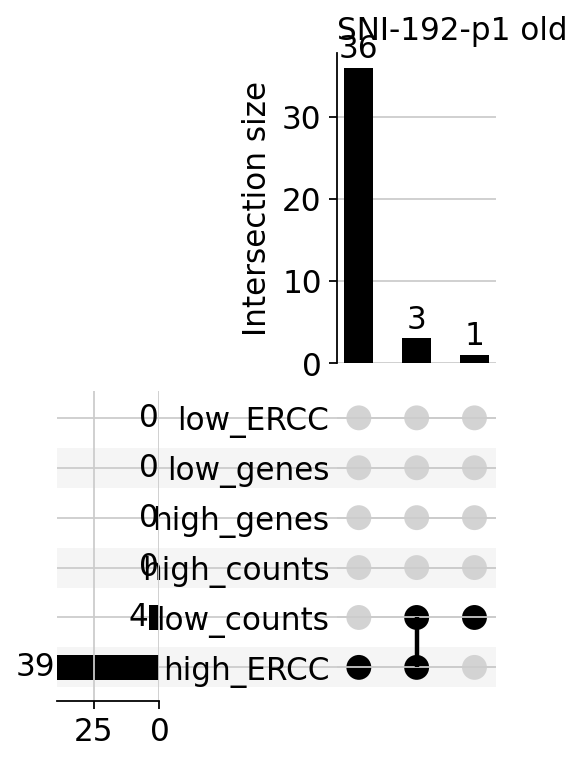

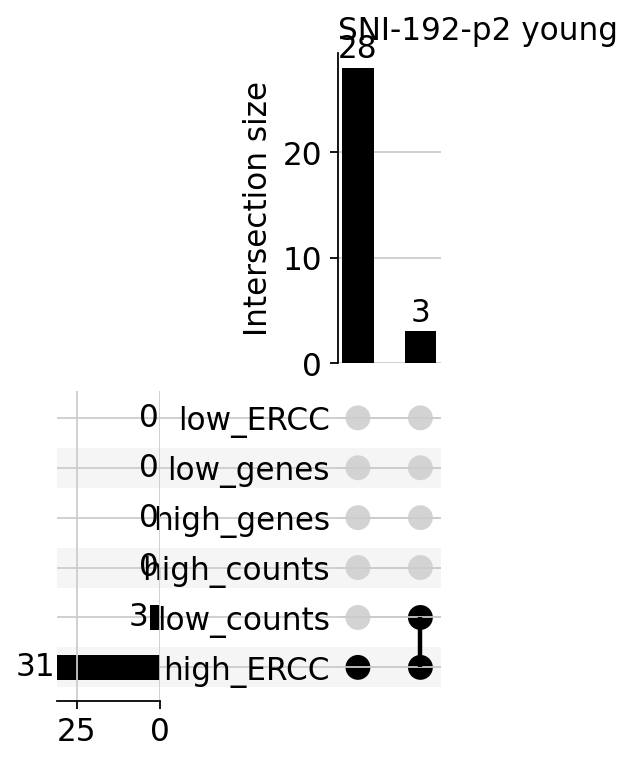

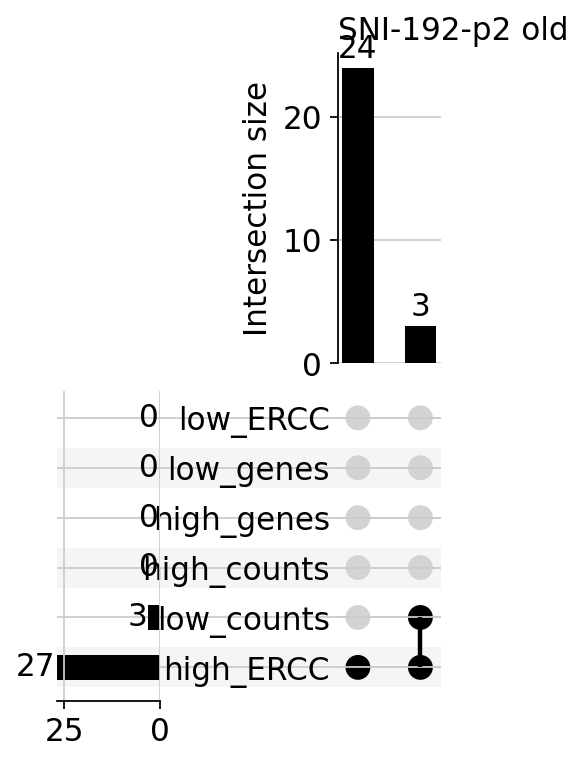

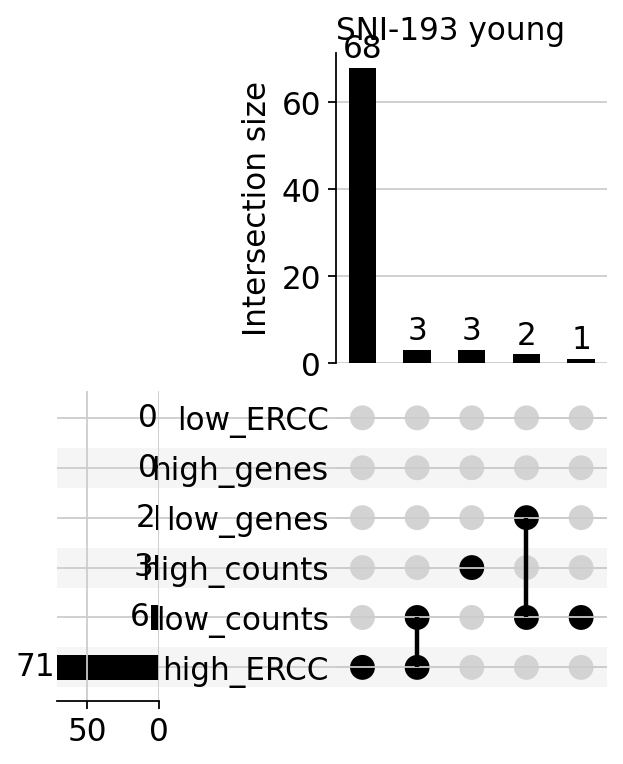

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/upsetplot/plotting.py:551: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  orig_ax.set_xlim(max_total, 0)


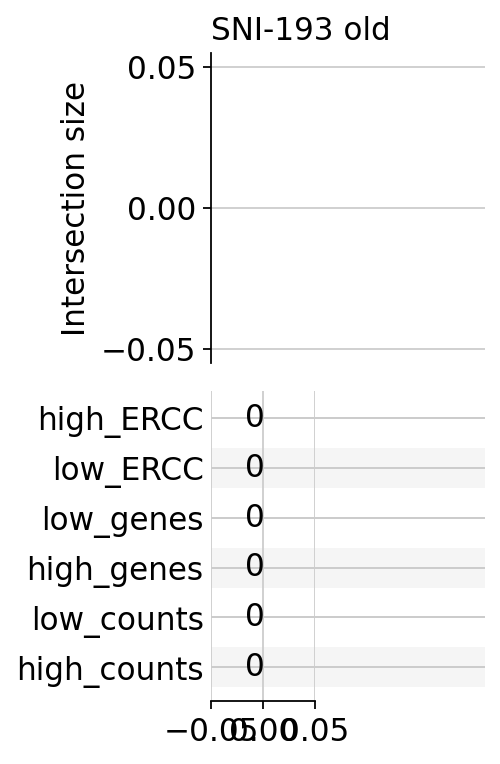

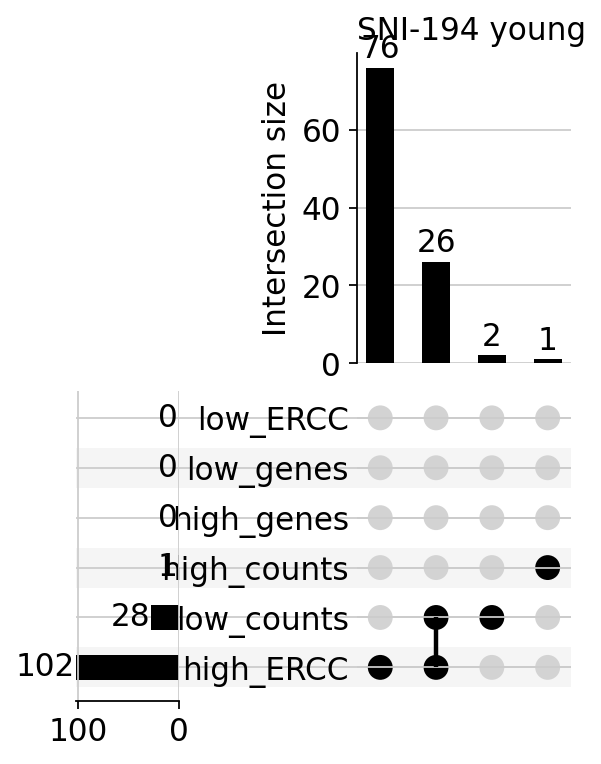

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/upsetplot/plotting.py:551: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  orig_ax.set_xlim(max_total, 0)


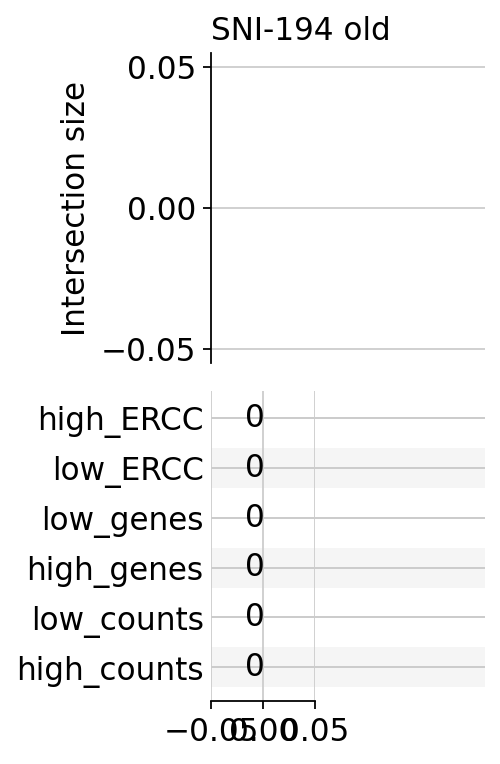

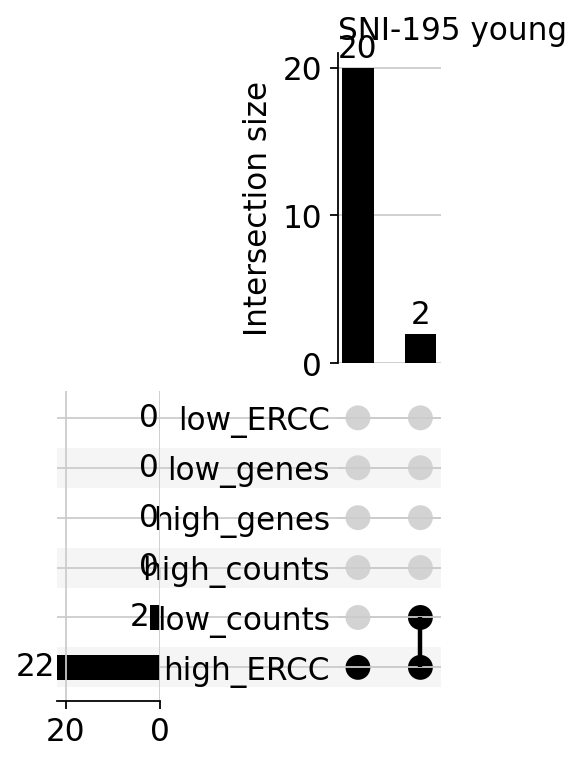

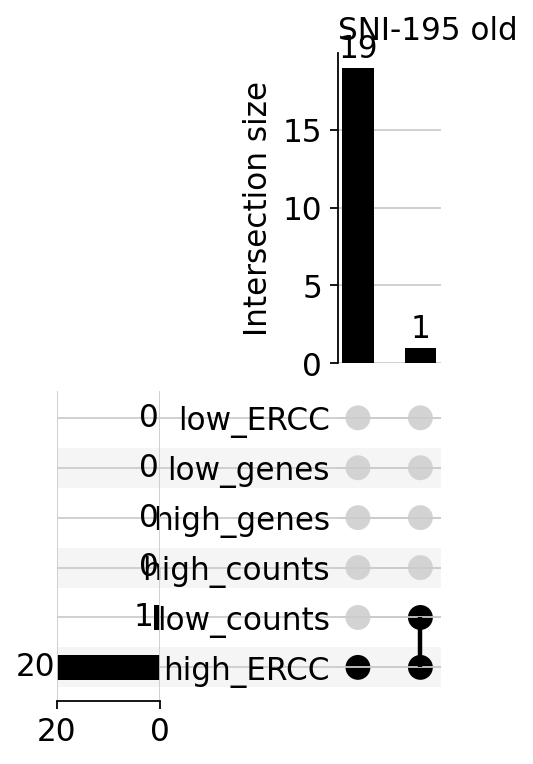

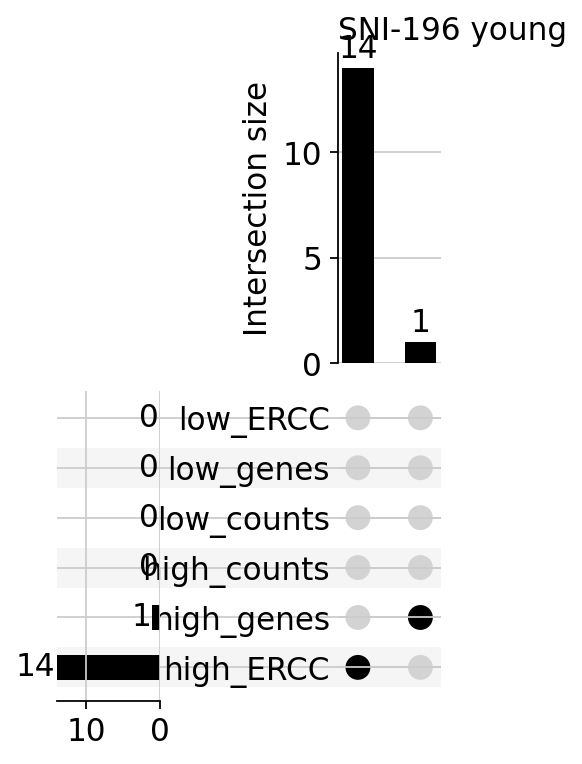

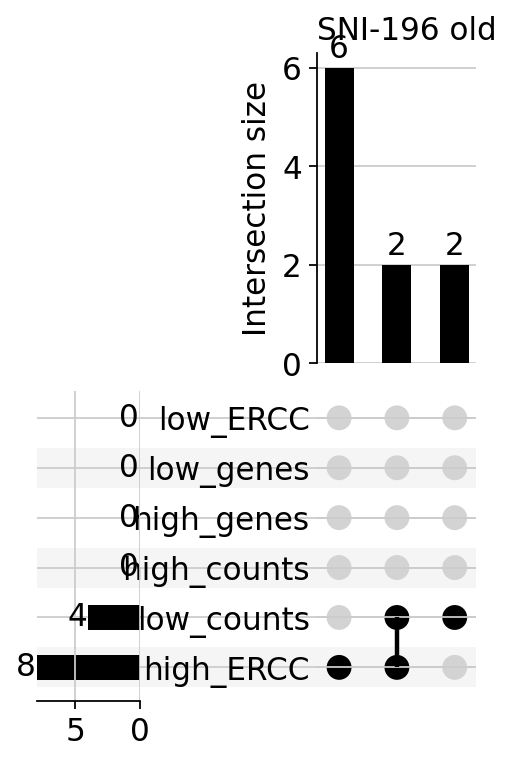

...

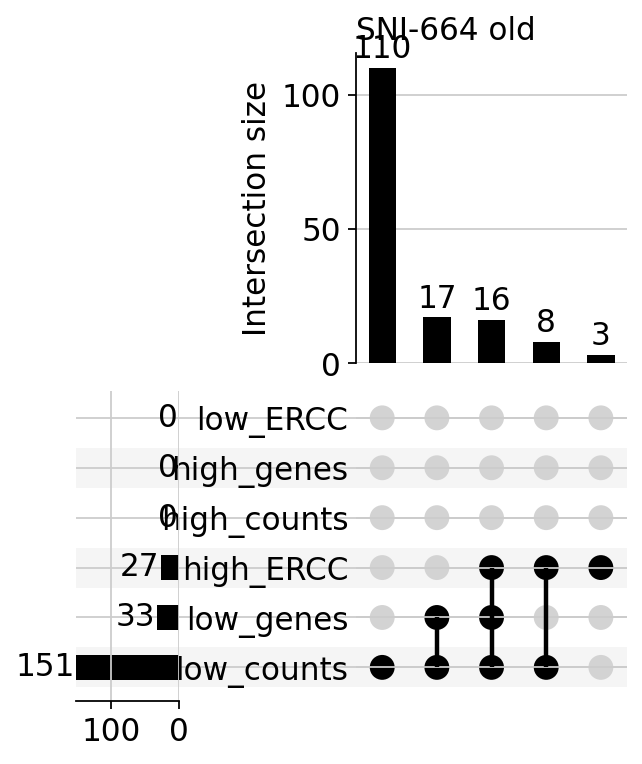

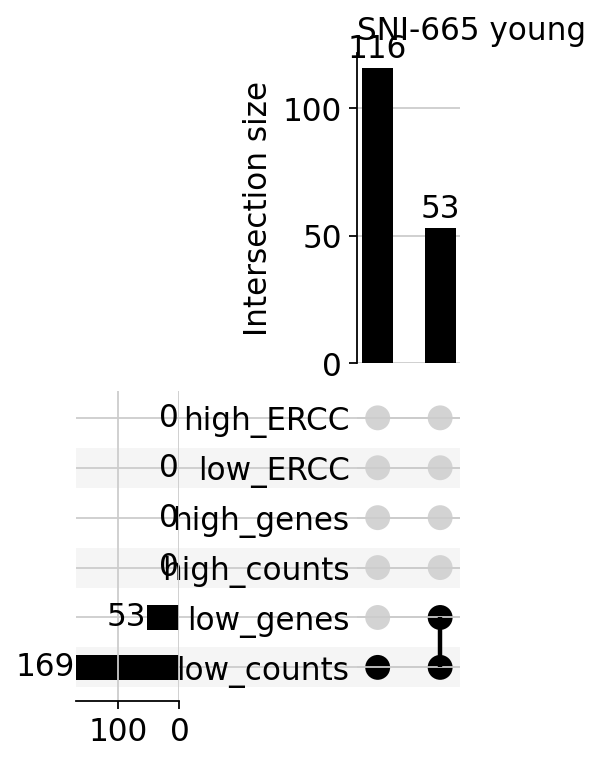

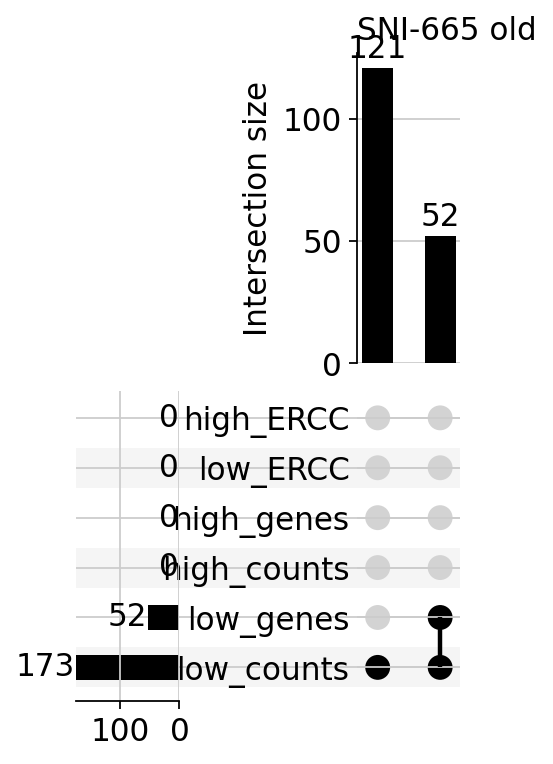

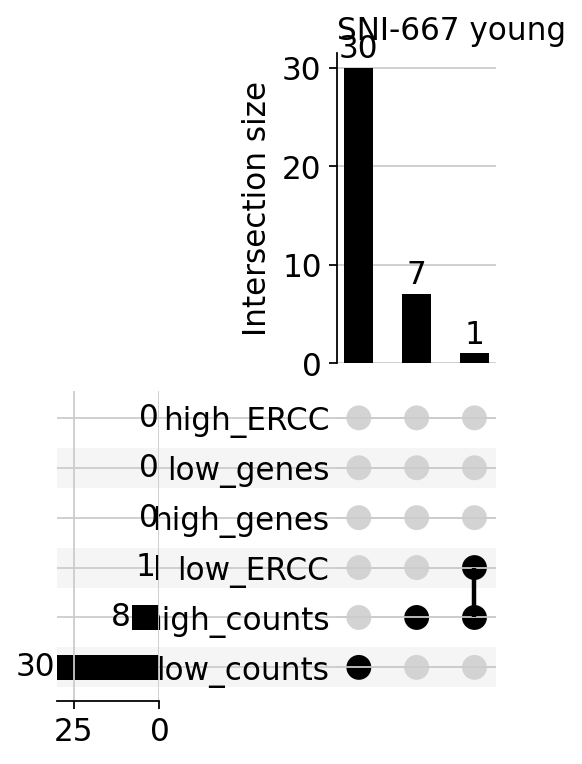

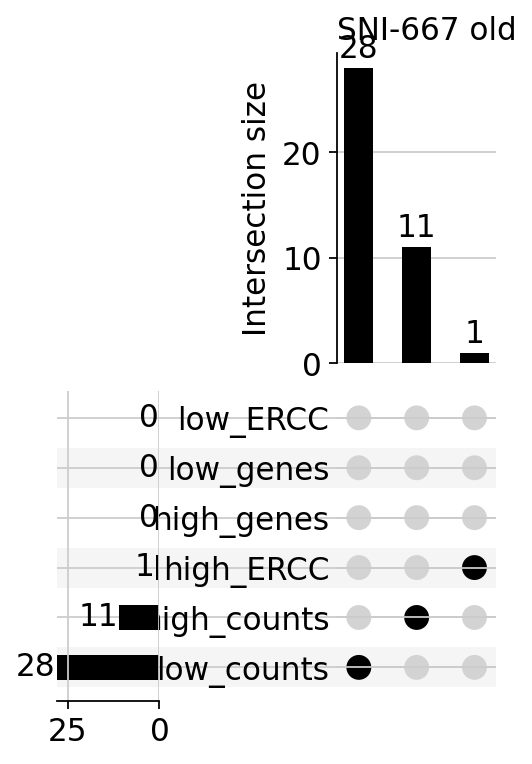

In [89]:
for sample in adata.obs['exp.'].cat.categories:
    
    sample_id = adata.obs['exp.']==sample
    obs_names = adata.obs_names[sample_id]
   
    for age in adata.obs['age_grouped'].cat.categories:
        
        age_id = adata.obs['age_grouped'] == age
        age_names = adata.obs_names[age_id]
        
        df_filter_tmp = df_filter[np.logical_and(np.in1d(df_filter.index, age_names),
                                                 np.in1d(df_filter.index, obs_names)
                                                )]
        df_test = df_filter_tmp.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')
        up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
        plt.title(sample + ' ' + age, loc='left')
        plt.savefig('./figures/'+today+ '_lenient_filtering_'+ sample+ '_' + age +'.pdf',bbox_inches='tight')
        plt.show()

### More stringent criteria:

In [90]:
adata.obs['high_ERCC'] = adata.obs["percentERCC"] > 0.9
adata.obs['low_ERCC'] = adata.obs["percentERCC"] <= 0.05

In [91]:
adata.obs['low_genes'] = adata.obs['n_genes']<1000
adata.obs['high_genes'] = adata.obs['n_genes']>=7000
adata.obs['low_counts'] = adata.obs['n_counts_transcripts'] <= 10000
adata.obs['high_counts'] = adata.obs['n_counts_transcripts'] >= 300000

In [92]:
df_filter = adata.obs[['high_ERCC', 'low_ERCC', 'low_genes', 
                        'high_genes', 'low_counts', 'high_counts']]

In [93]:
low_qual_id = df_filter.sum(1)>0

df_filter = df_filter[low_qual_id]

In [94]:
low_qual_id.sum()

2020

In [95]:
df_filter.head()

,high_ERCC,low_ERCC,low_genes,high_genes,low_counts,high_counts
do20280,True,False,False,False,True,False
do20281,True,False,False,False,True,False
do20286,True,False,False,False,True,False
do20289,True,False,False,False,True,False
do20291,True,False,True,False,True,False


In [96]:
df_filter['c'] = '1'

In [97]:
df_test = df_filter.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')

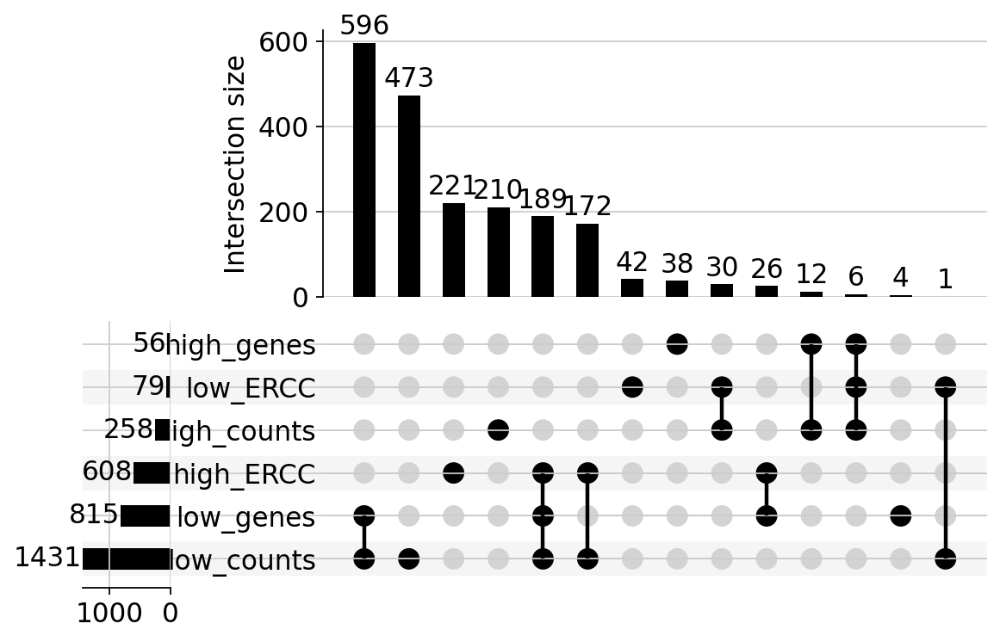

In [98]:
rcParams['figure.figsize']=(10,5)
up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
plt.savefig('./figures/'+today+ '_current_filtering_all.pdf',bbox_inches='tight')
plt.show()

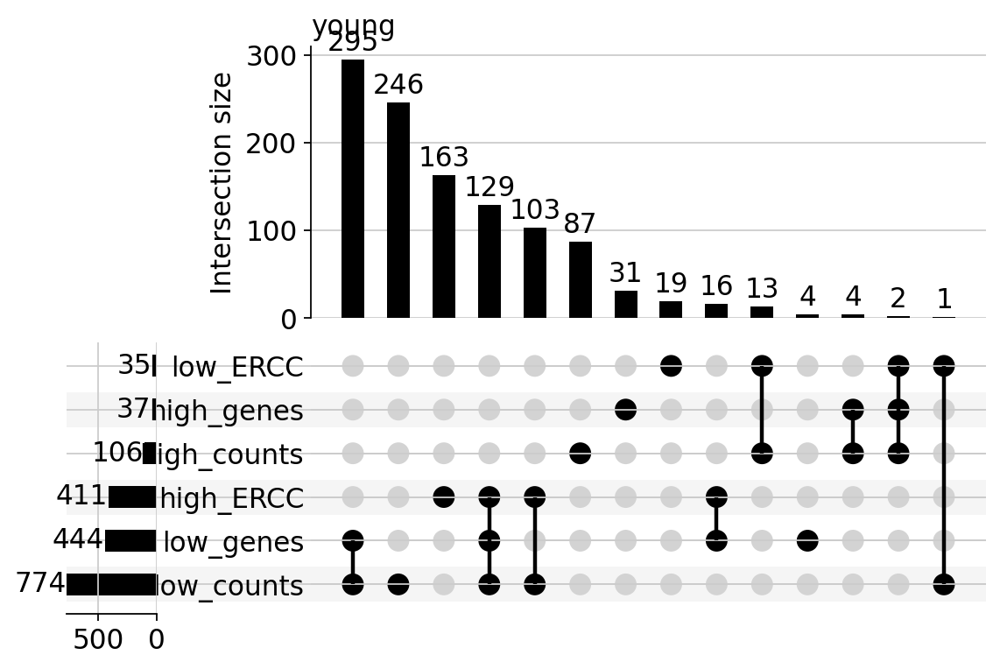

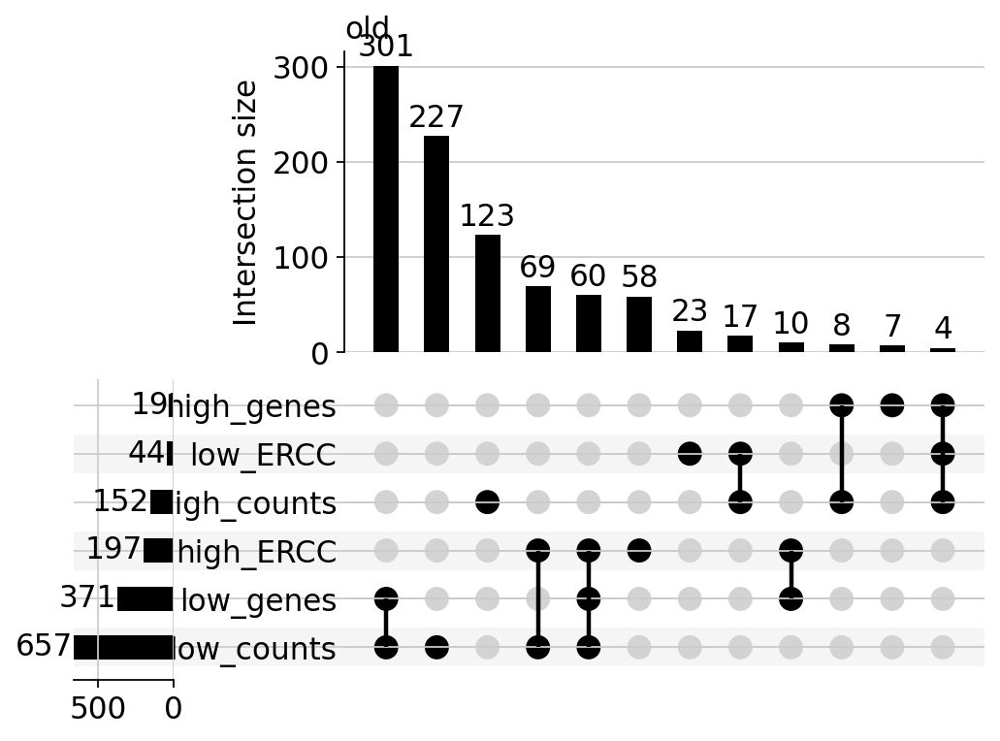

In [99]:
for age in adata.obs['age_grouped'].cat.categories:
    age_id = adata.obs['age_grouped'] == age
    age_names = adata.obs_names[age_id]
        
    df_filter_tmp = df_filter[np.in1d(df_filter.index, age_names)]
    df_test = df_filter_tmp.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')
    up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
    plt.title(age, loc='left')
    plt.savefig('./figures/'+today+ '_current_filtering_'+ age +'.pdf',bbox_inches='tight')
    plt.show()

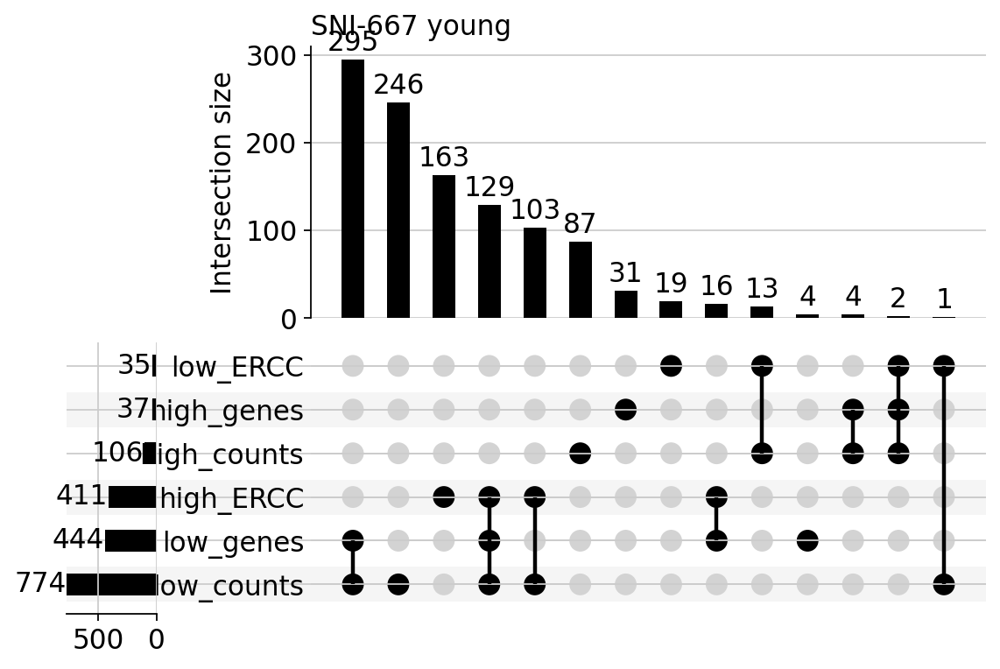

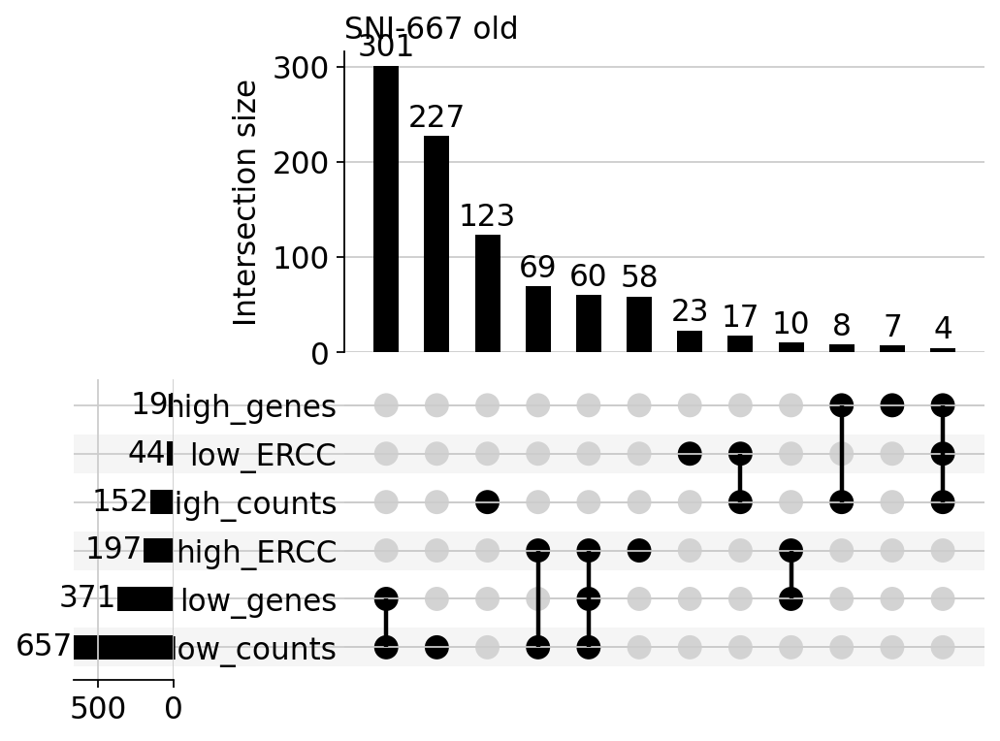

In [100]:
for age in adata.obs['age_grouped'].cat.categories:
    age_id = adata.obs['age_grouped'] == age
    age_names = adata.obs_names[age_id]
        
    df_filter_tmp = df_filter[np.in1d(df_filter.index, age_names)]
    df_test = df_filter_tmp.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')
    up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
    plt.title(sample + ' ' + age, loc='left')
    plt.savefig('./figures/'+today+ '_lenient_filtering_'+ age +'.pdf',bbox_inches='tight')
    plt.show()

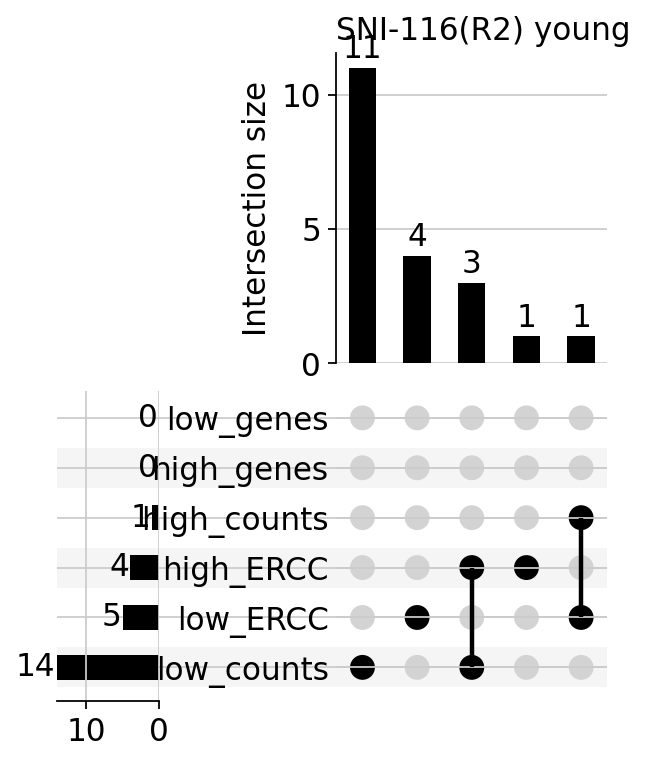

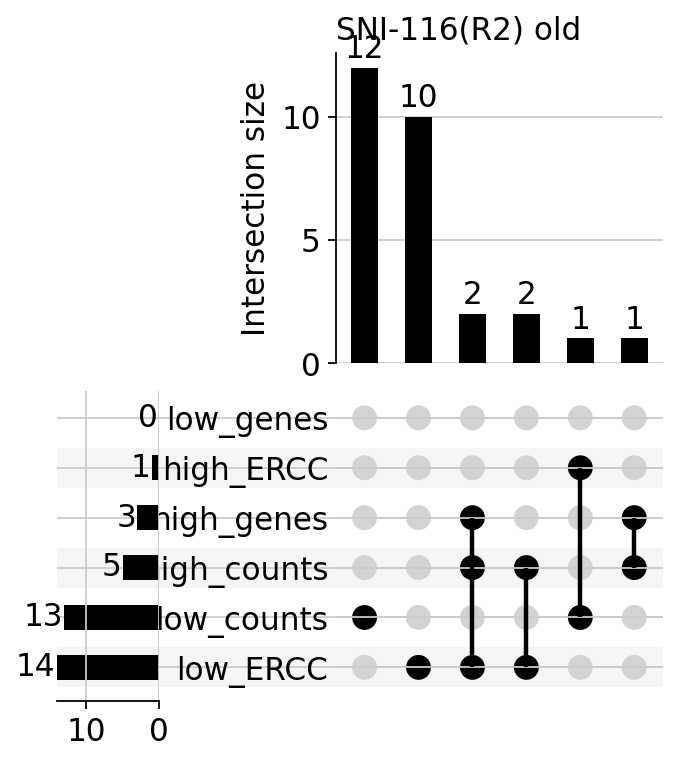

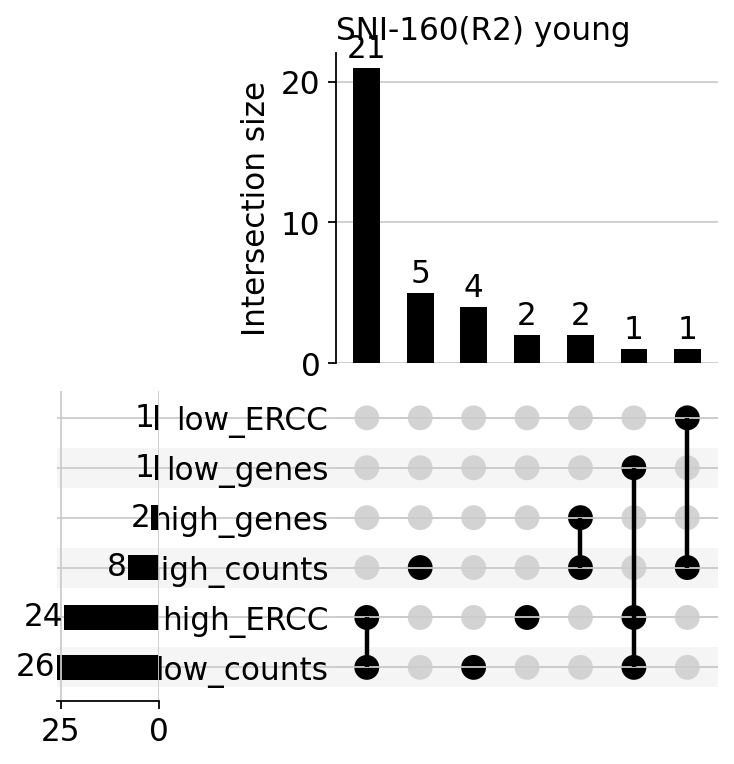

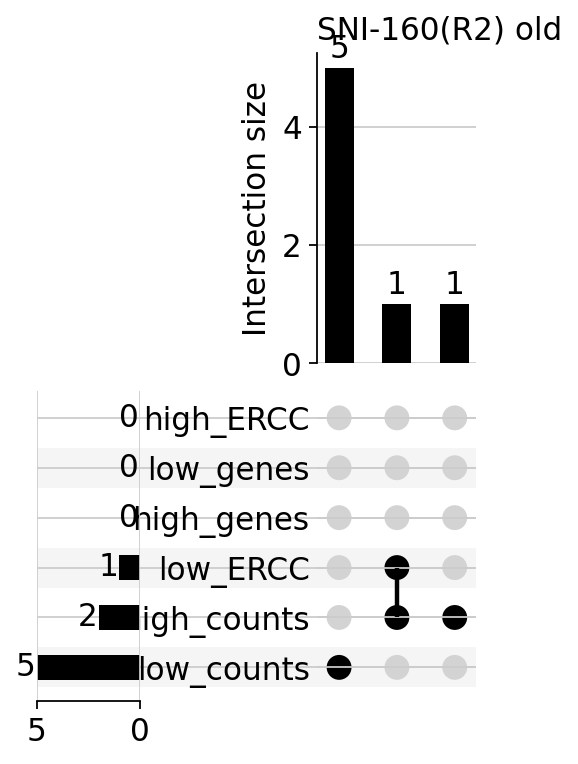

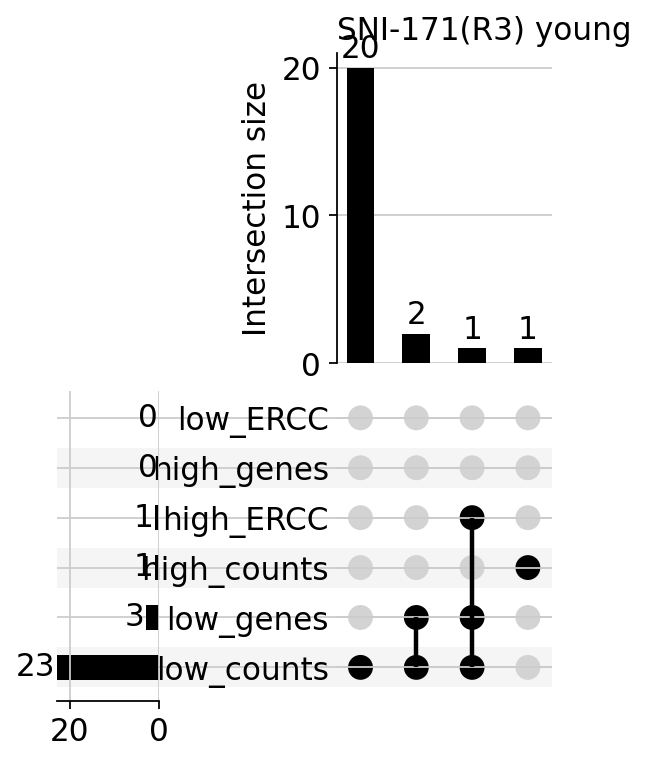

...

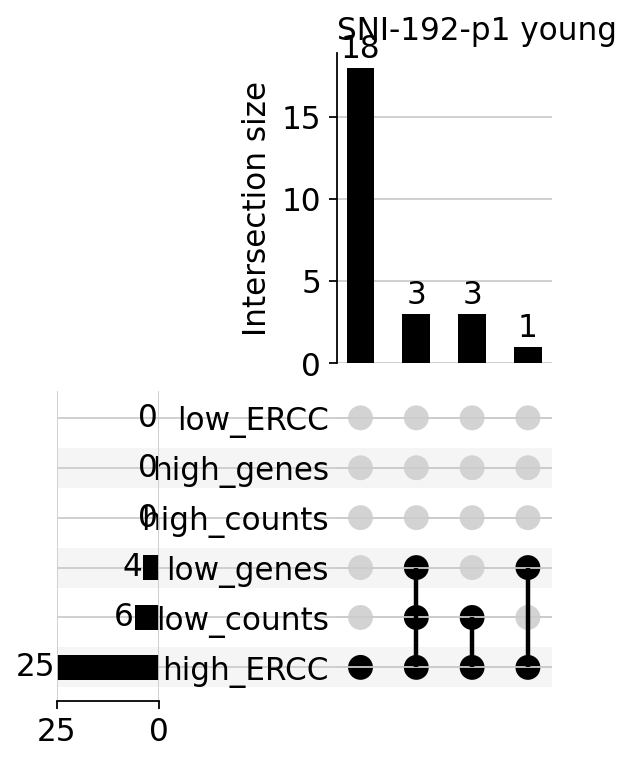

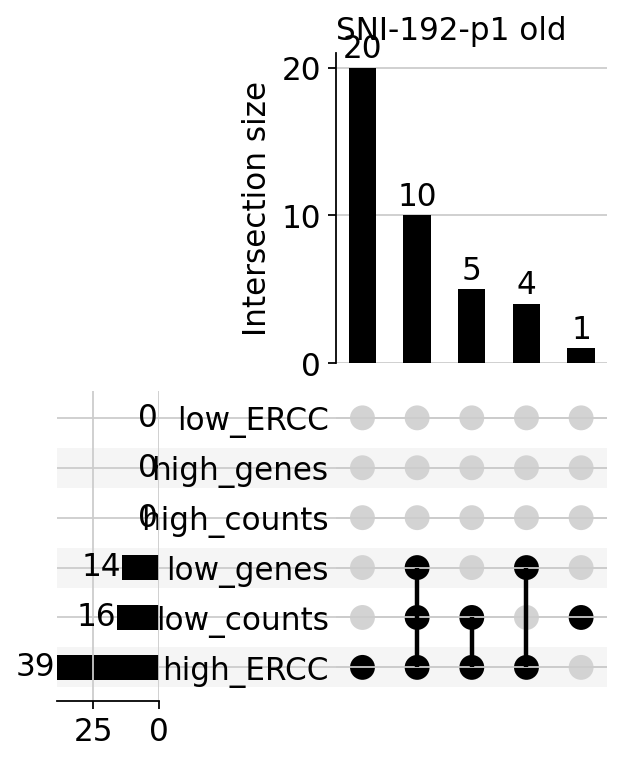

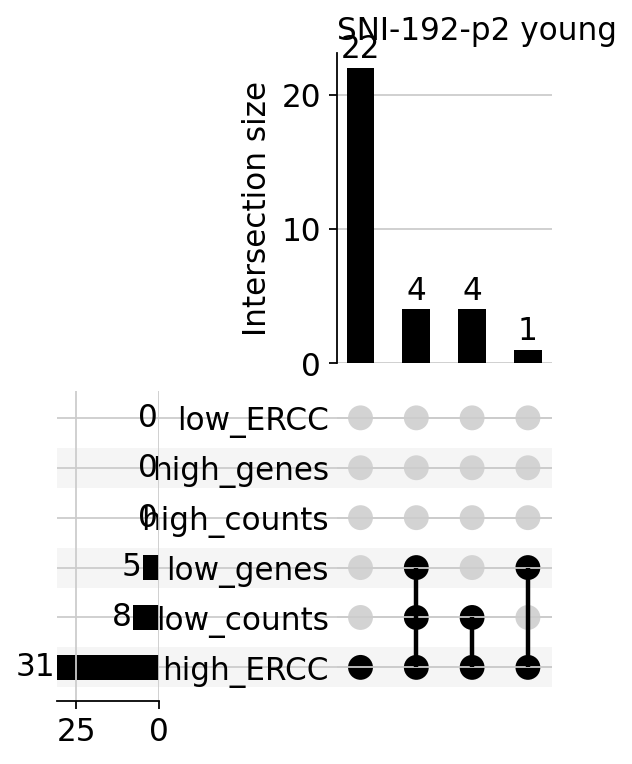

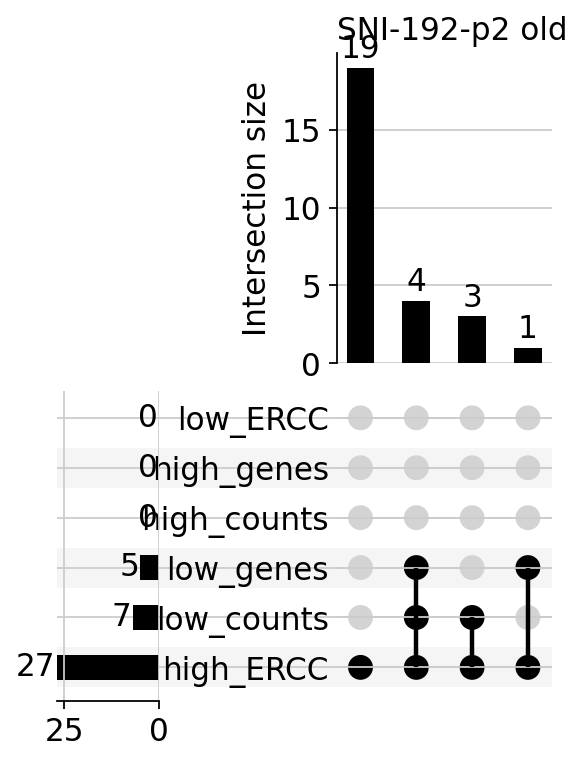

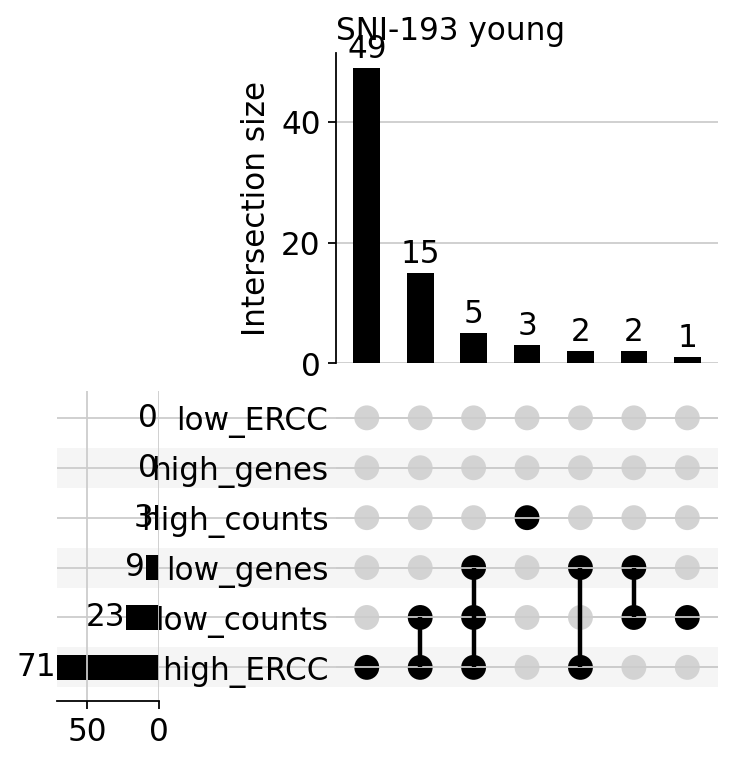

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/upsetplot/plotting.py:551: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  orig_ax.set_xlim(max_total, 0)


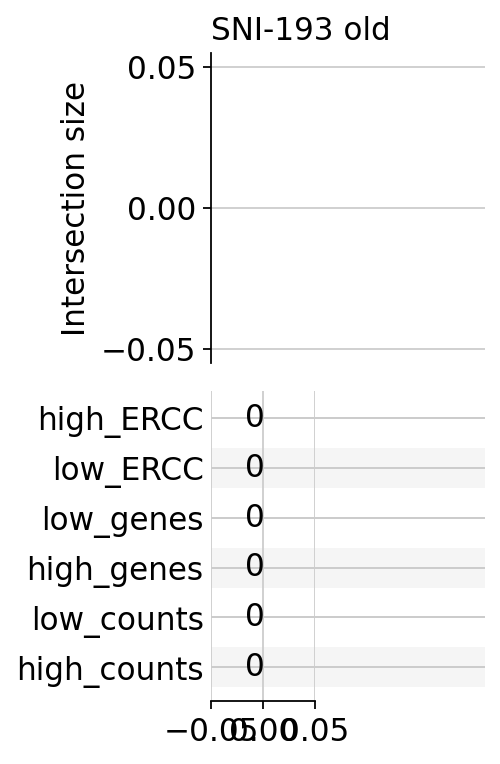

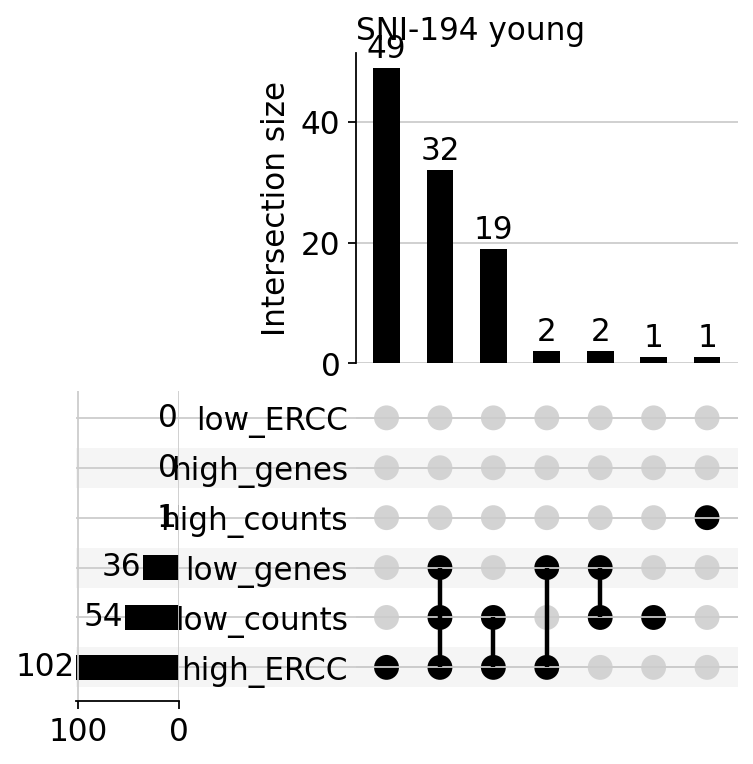

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/upsetplot/plotting.py:551: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  orig_ax.set_xlim(max_total, 0)


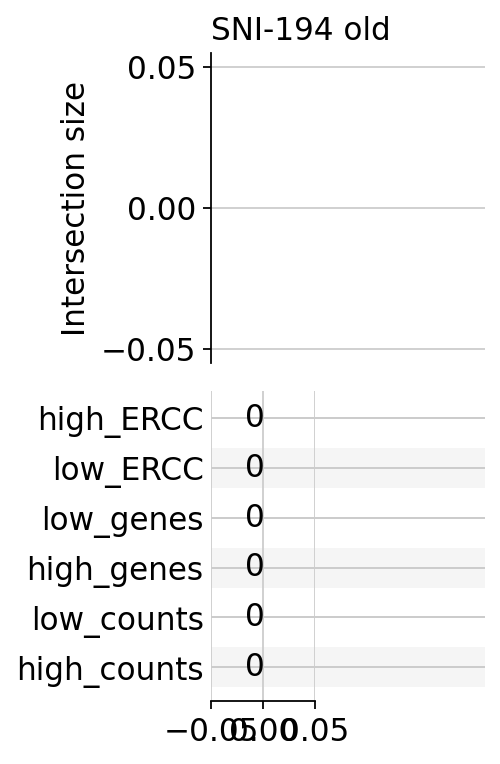

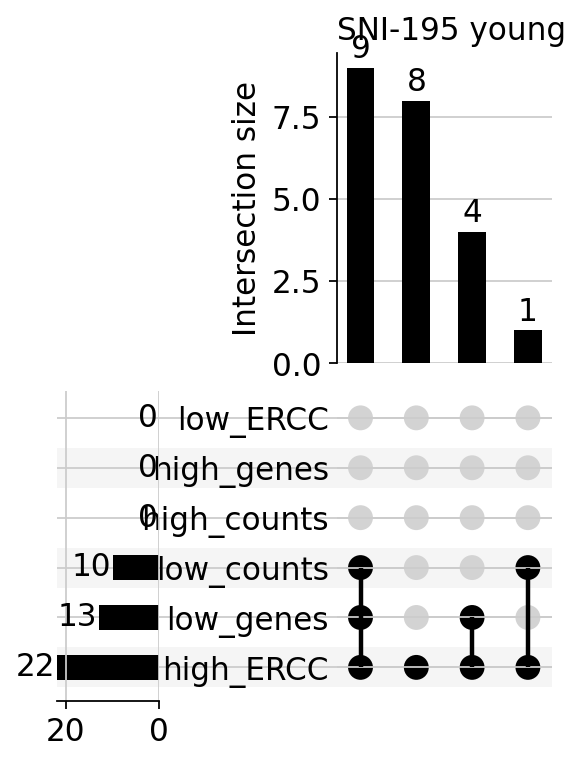

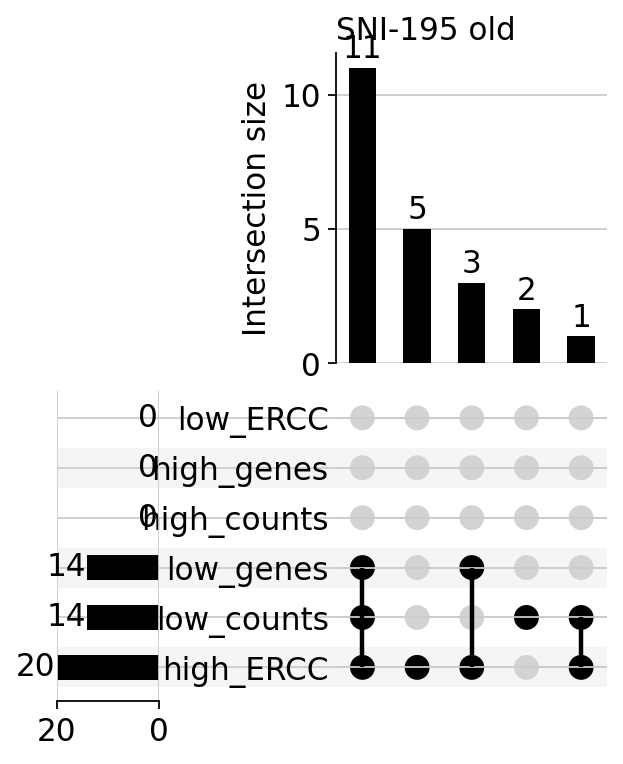

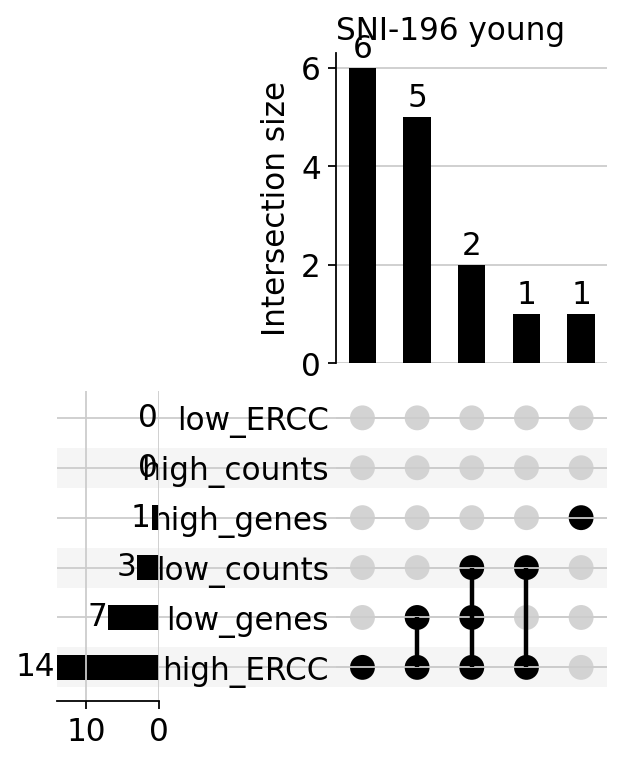

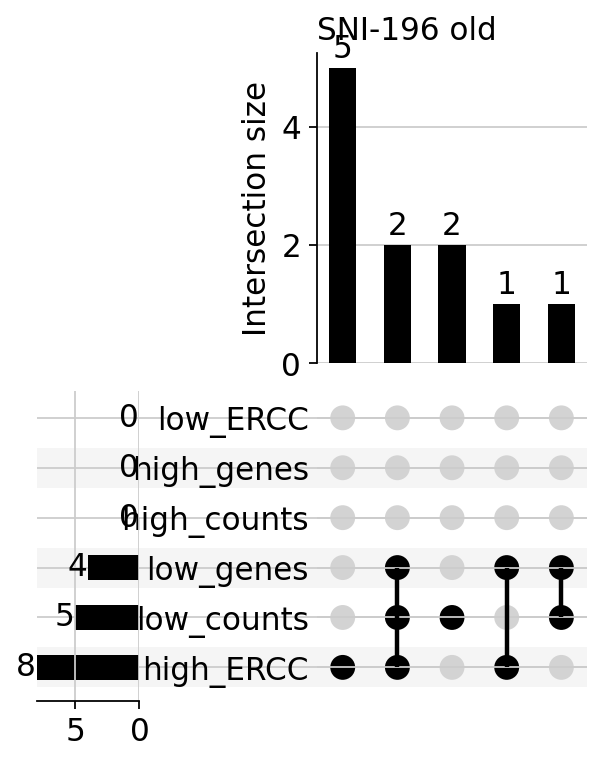

...

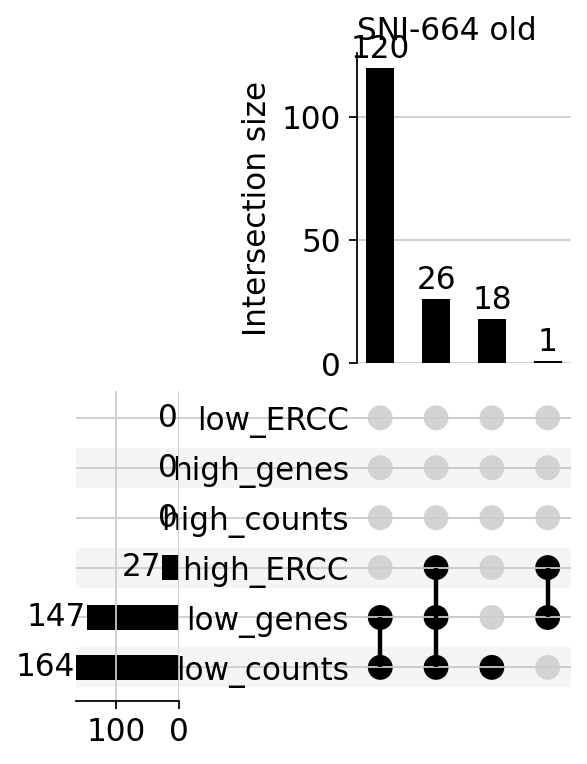

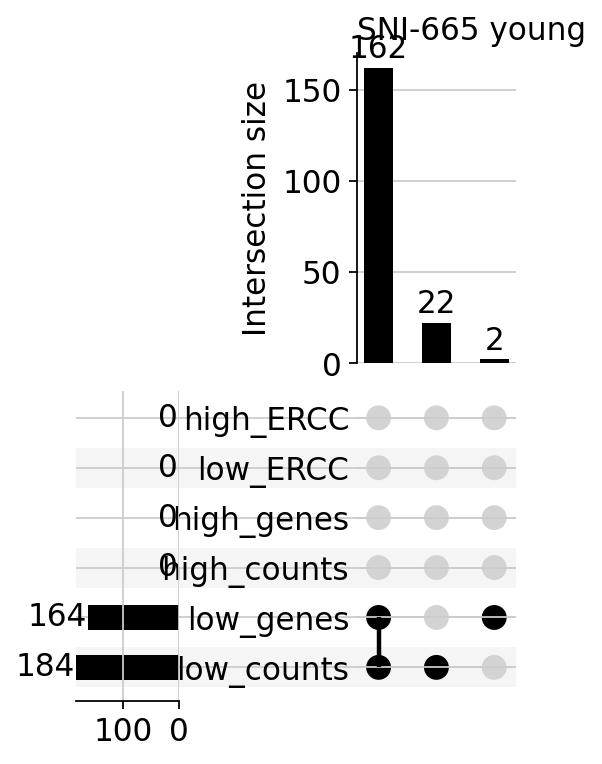

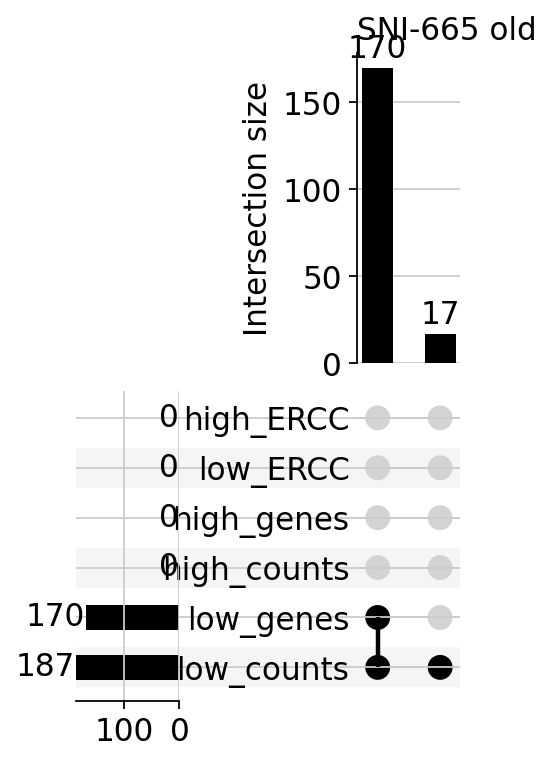

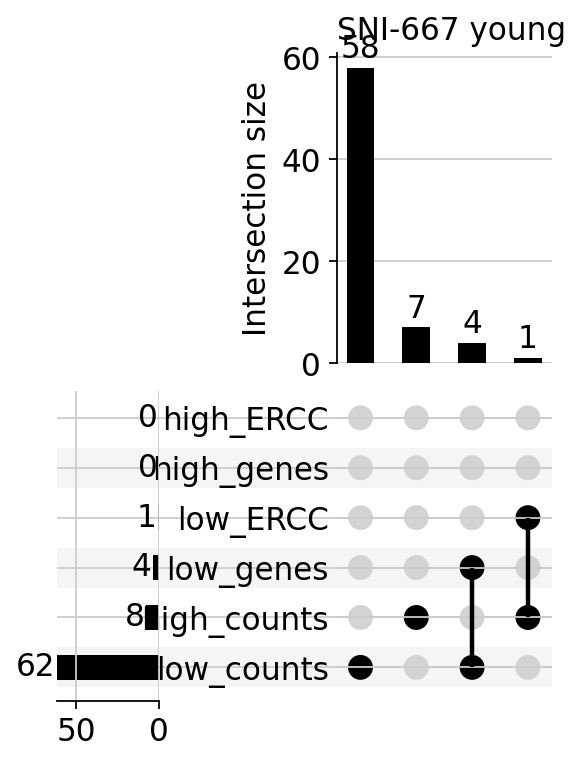

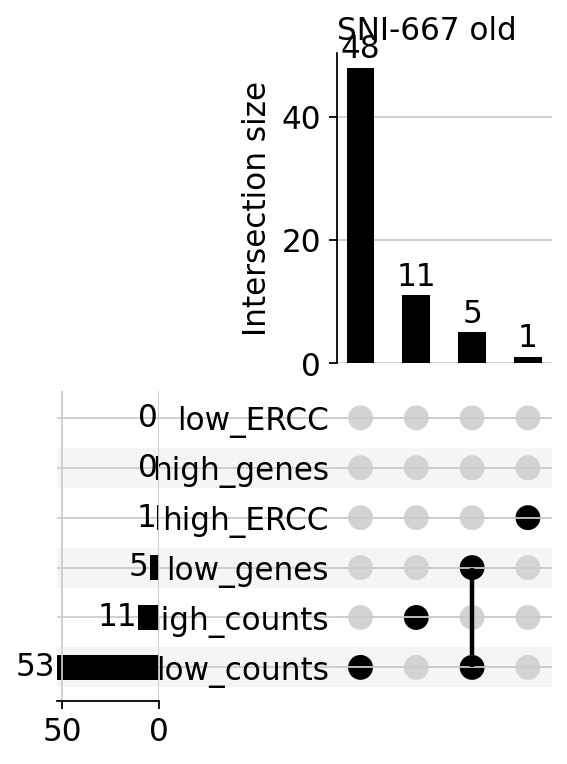

In [101]:
for sample in adata.obs['exp.'].cat.categories:
    
    sample_id = adata.obs['exp.']==sample
    obs_names = adata.obs_names[sample_id]
   
    for age in adata.obs['age_grouped'].cat.categories:
        
        age_id = adata.obs['age_grouped'] == age
        age_names = adata.obs_names[age_id]
        
        df_filter_tmp = df_filter[np.logical_and(np.in1d(df_filter.index, age_names),
                                                 np.in1d(df_filter.index, obs_names)
                                                )]
        df_test = df_filter_tmp.groupby(['high_ERCC', 'low_ERCC', 'low_genes', 
                    'high_genes','low_counts', 'high_counts']).count().sort_values('c')
        up.plot(df_test['c'], sort_by="cardinality", show_counts='%d')
        plt.title(sample + ' ' + age, loc='left')
        plt.savefig('./figures/'+today+ '_current_filtering_'+ sample+ '_' + age +'.pdf',bbox_inches='tight')
        plt.show()

In [102]:
adata_new = adata[adata.obs["percentERCC"] <= 0.9,:].copy()
adata_new = adata_new[adata_new.obs["percentERCC"] > 0.05,:].copy()

adata_new.obs['exp.'].value_counts().to_csv(data_dir + 'cell_number_after_ERCC_filter.csv')
sc.pp.filter_cells(adata_new, min_genes=200) 
adata_new.obs['exp.'].value_counts().to_csv(data_dir + 'cell_number_after_minGene_filter.csv')
sc.pp.filter_genes(adata_new, min_counts=50)

In [103]:
adata_new

AnnData object with n_obs × n_vars = 8392 × 30612
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts'

Trying to set attribute `.uns` of view, copying.


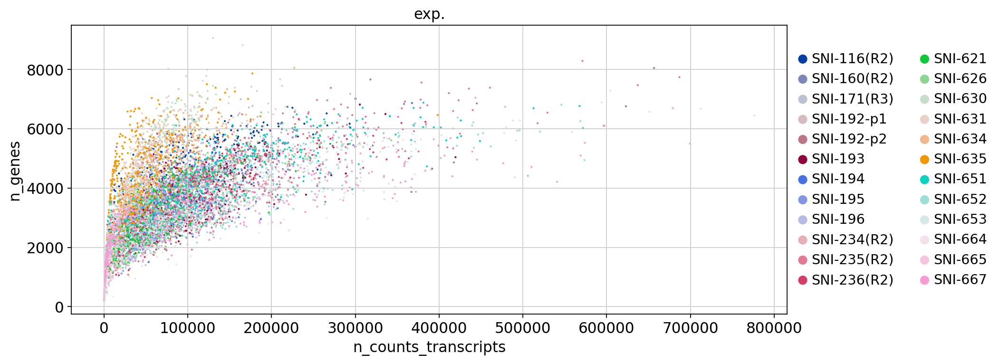

In [21]:
rcParams['figure.figsize']= (10,5)
sc.pl.scatter(adata_new[adata_new.obs['n_counts']<1e6], 'n_counts_transcripts', 'n_genes', 
              color='exp.', save='_' + today + '_genes_vs_transcripts.pdf')

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'ploidy' as categorical


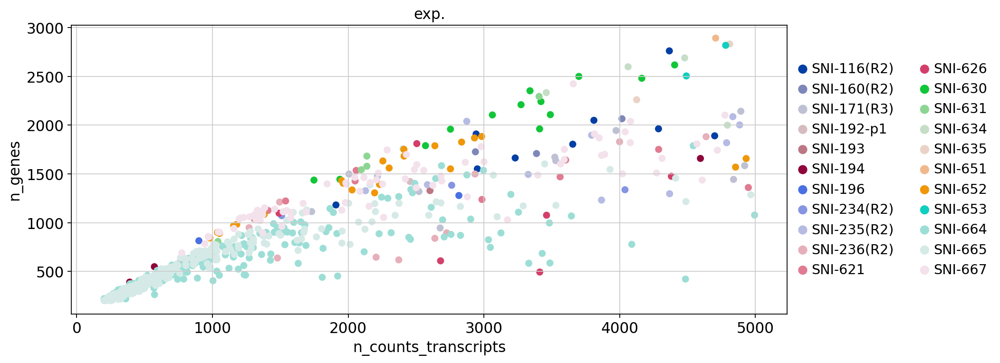

In [105]:
rcParams['figure.figsize']= (10,5)
sc.pl.scatter(adata_new[adata_new.obs['n_counts_transcripts']<5e3], 'n_counts_transcripts', 'n_genes', 
              color='exp.', save= '_' + today +'_genes_vs_transcripts_lower.pdf')

In [128]:
## further filtering: 
adata2 = adata_new.copy()

# remove cells with 2x2n and - ploidy (doublets and empty wells from FACS failure)
adata2 = adata2[adata2.obs['ploidy'] != '2-2n', :]
adata2 = adata2[adata2.obs['ploidy'] != '-', :]

# remove cells with more than 7000 genes covered
adata2 = adata2[adata2.obs['n_genes'] < 7000, :]

# remove cells with less than 2,500 transcript counts for old and 3,500 transcript count for young
low_count_filter = [adata2.obs['n_counts_transcripts'][idx] > 2500 
                    if adata2.obs['age_grouped'][idx]=='old' else 
                    adata2.obs['n_counts_transcripts'][idx] > 3500 
                    for idx in range(adata2.n_obs)]
adata2 = adata2[low_count_filter, :]
# remove cells with more than 300,000 transcript counts
adata2 = adata2[adata2.obs['n_counts_transcripts'] < 300000, :]

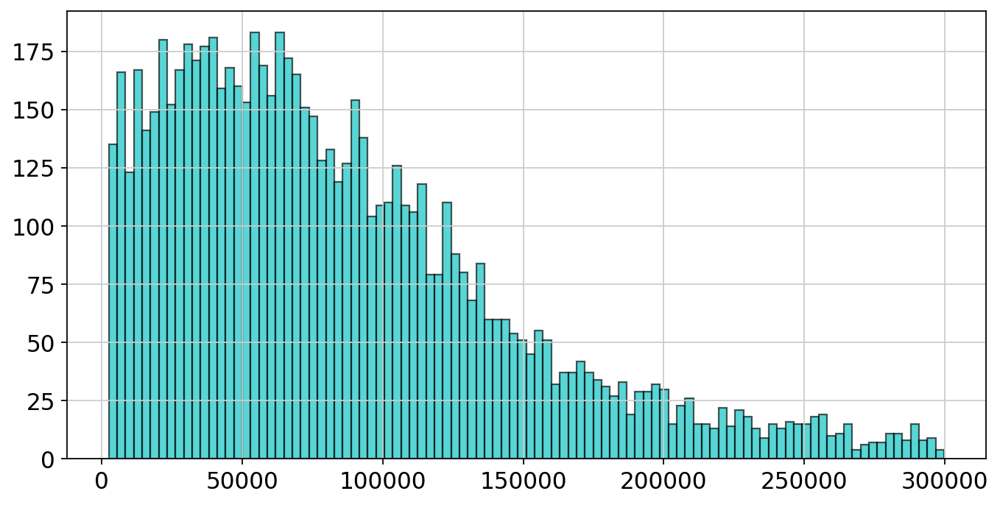

In [129]:
p = plt.hist(adata2.obs["n_counts_transcripts"], bins=100, color='c', edgecolor='k', alpha=0.65)

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'strain' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sex' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'ploidy' as categorical


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


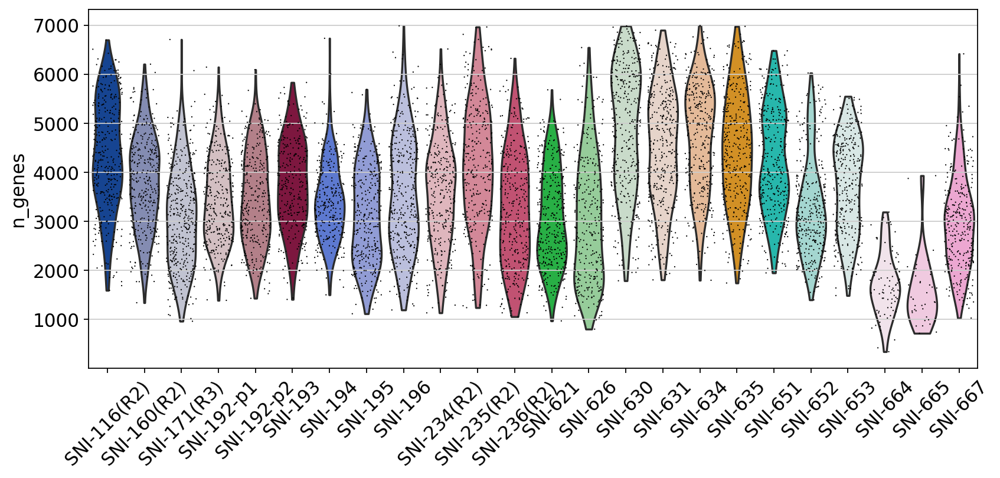

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


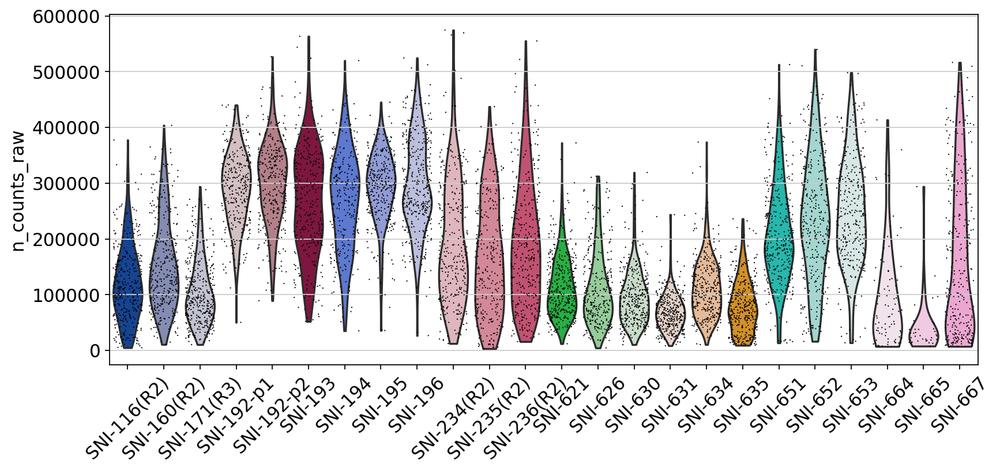

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


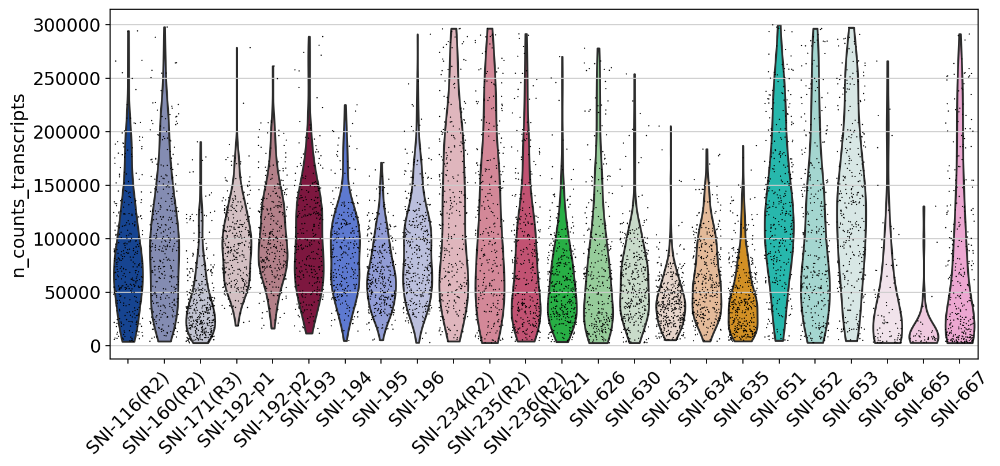

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


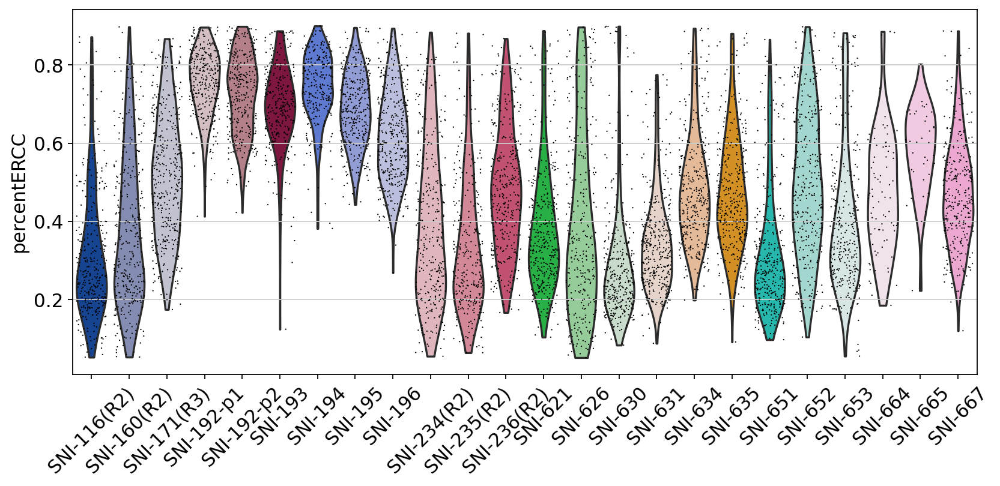

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


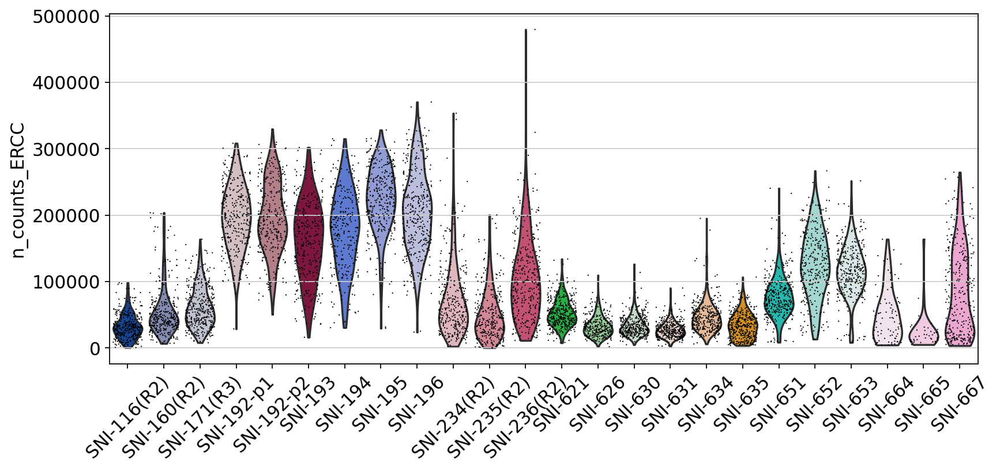

In [130]:
for obs in ['n_genes', 'n_counts_raw',  "n_counts_transcripts",'percentERCC', "n_counts_ERCC"]:
    sc.pl.violin(adata2, obs, groupby='exp.', rotation=45,
             jitter=0.4, save = '_' + today + '_' + obs + '.pdf')


In [131]:
# number of genes per cell for comarison to other methods
df = pd.DataFrame()
df["n_genes"] = adata2.obs["n_genes"]
df["dataset"] = "snRNAseq2"
df.to_csv(data_dir + "/ko_normal_data_filtered_" + today +".csv")

### ERCC size factor calculation

In [132]:
ERCC = []
for i in adata2.var_names:
    if i[0:3] != "ENS" and i[0:2] != "__":
        ERCC.append(i)

In [133]:
# separate the matrix into the 2 dilutions and calculate the ERCC size factor separately 
adataHD = adata2[adata2.obs["ERCC.dilution"] == "1:300.000",:].copy()
adataLD = adata2[adata2.obs["ERCC.dilution"] == "1:100.000",:].copy()
adataHD.obs["ERCC_size_factor"] = np.sum(adataHD[:,ERCC].X, axis=1)/np.mean(np.sum(adataHD[:,ERCC].X, axis=1))
adataLD.obs["ERCC_size_factor"] = np.sum(adataLD[:,ERCC].X, axis=1)/np.mean(np.sum(adataLD[:,ERCC].X, axis=1))

In [134]:
adata2 = adataLD.concatenate(adataHD, index_unique=None)

### Finally remove ERCC reads from the matrix

In [135]:
red_trans = []
for i in adata2.var_names:
    if i[0:3] == "ENS":
        red_trans.append(i) # endogeneous transcripts
        
adata2 = adata2[:,red_trans].copy()        

Store raw counts as a layer

In [136]:
adata2.layers["counts"] = adata2.X.copy()

### Gene length and size factor normalization

In [137]:
# divide each column by transcript length (per 1kb)
for j in range(0, len(adata2.var)):
    adata2.X[:,j] = adata2.X[:,j]/(adata2.var["length"][j]/1000) 

adata2.obs['n_counts_TPM'] = adata2.X.sum(axis=1)

# sum the gene length-corrected counts per cell and divide by 10,000 times the ERCC size factor
adata2.obs['RPK_factor'] = adata2.obs['n_counts_TPM']/(adata2.obs['ERCC_size_factor']*10000)

# divide each row by the size factor
for i in range(0,len(adata2)):
     adata2.X[i,:] = adata2.X[i,:]/adata2.obs["RPK_factor"][i]
adata2.obs['n_counts_TPM_norm'] = adata2.X.sum(axis=1)

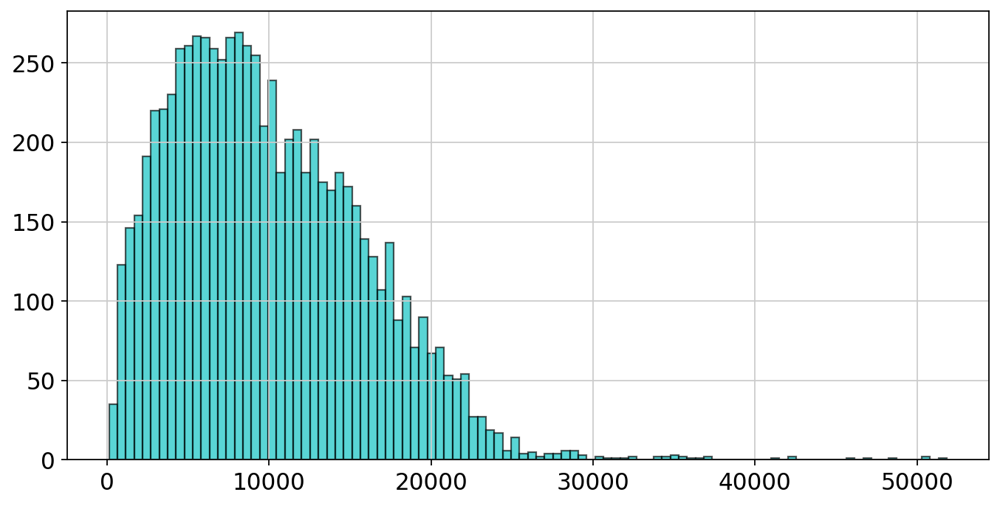

In [138]:
# plotting the normalized counts per cell
p = plt.hist(adata2.obs["n_counts_TPM_norm"], bins=100, color='c', edgecolor='k', alpha=0.65)

Store normalized counts as layer

In [139]:
adata2.layers["norm_counts"] = adata2.X.copy()

... storing 'exp.' as categorical
... storing 'age' as categorical
... storing 'ERCC.dilution' as categorical
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


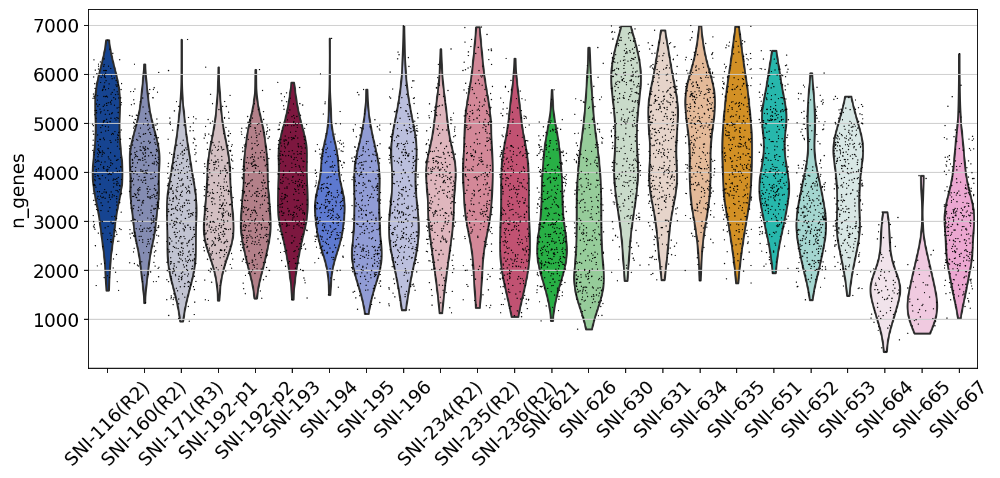

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


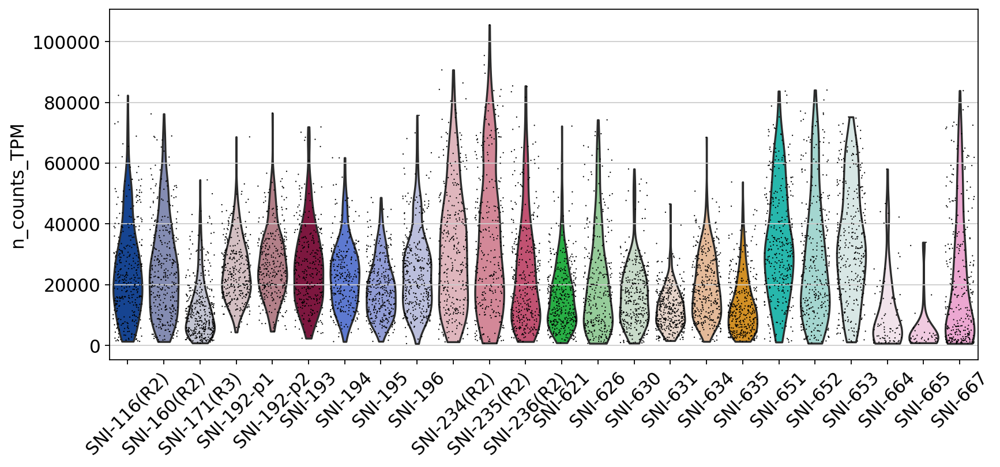

In [140]:
for obs in ['n_genes', 'n_counts_TPM']:
    sc.pl.violin(adata2, obs, groupby='exp.', rotation=45,
             jitter=0.4, save = '_' + today + obs + '_norm.pdf')


Additional filtering: removing cells with high gene length-corrected counts.

In [141]:
adata2 = adata2[adata2.obs["n_counts_TPM"] <= 60000,:]

In [142]:
# remove the technical replicates
adata2 = adata2[adata2.obs["exp."] != "SNI-234(R2)",:]
adata2 = adata2[adata2.obs["exp."] != "SNI-235(R2)",:]

In [143]:
# low quality plates
adata2 = adata2[adata2.obs["exp."] != "SNI-664",:]
adata2 = adata2[adata2.obs["exp."] != "SNI-665",:]

In [144]:
# mean and median transcript count after filtering and normalization
adata2.obs["mean_transcript_count_TPM"] = np.mean(adata2.X, axis=1)
adata2.var["mean_exp_TPM"] = np.mean(adata2.X, axis=0)
adata2.var["median_exp_TPM"] = np.median(adata2.X, axis=0)

Trying to set attribute `.obs` of view, copying.


In [145]:
adata2

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'exp._colors'
    layers: 'counts', 'norm_counts'

Log-scale.

In [146]:
sc.pp.log1p(adata2)

Store logarithmized data as `adata.raw` and as additional layer.

In [147]:
adata2.raw = adata2
adata2.layers["raw"] = adata2.X

Store binary expression as additional layer.

In [148]:
adata3 = adata2.copy()
adata3.X[adata3.X != 0] = 1
adata2.layers["raw_bin"] = adata3.X

## Visualization

In [149]:
sc.pp.pca(adata2)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)

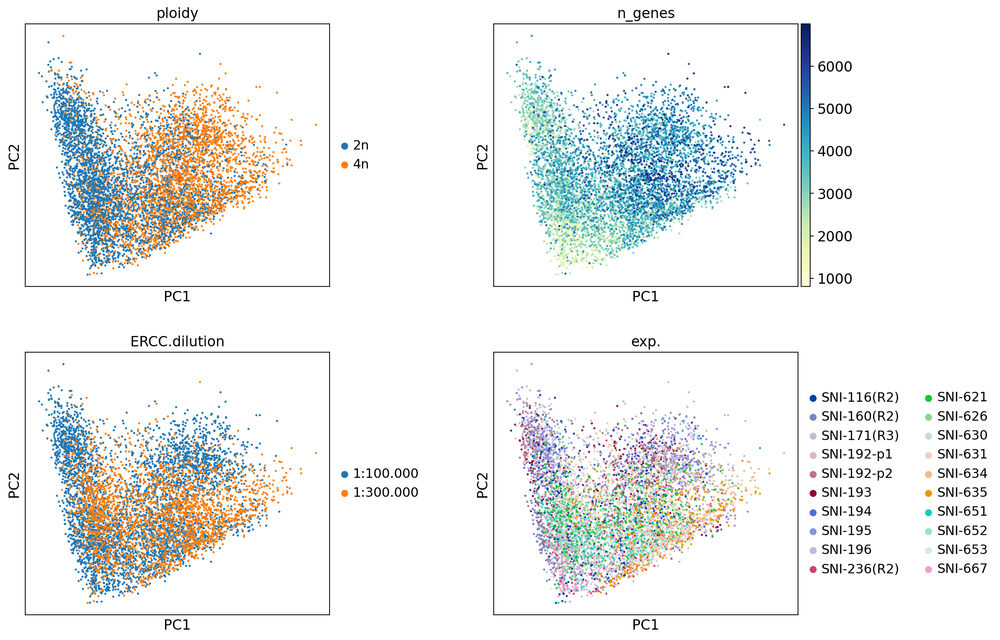

In [150]:
# PCA
rcParams['figure.figsize']=(5,5)
sc.pl.pca_scatter(adata2, color=["ploidy","n_genes", "ERCC.dilution", "exp."], ncols=2, wspace=0.4, 
                  save= '_' + today +'_normalised.pdf')

In [151]:
# t-SNE
sc.tl.tsne(adata2, perplexity=50, n_pcs=10)

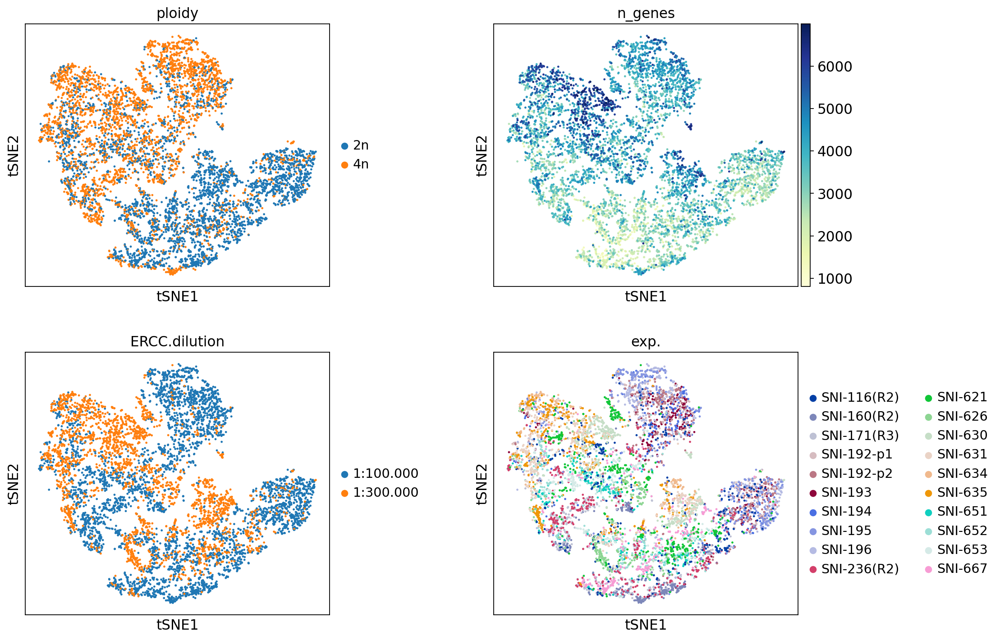

In [152]:
sc.pl.tsne(adata2, color=[ "ploidy", "n_genes", "ERCC.dilution", "exp."],
           ncols=2, wspace=0.4, 
           save= '_' + today +'_normalised.pdf')

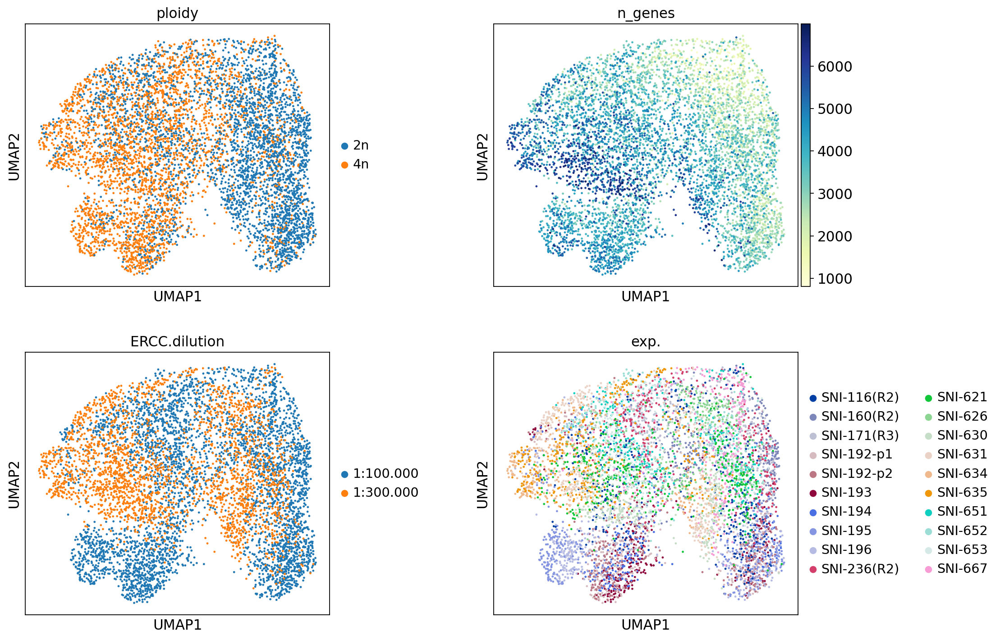

In [153]:
# UMAP
sc.pl.umap(adata2, color=[ "ploidy", "n_genes", "ERCC.dilution", "exp."],
           ncols=2, wspace=0.4, save= '_' + today +'_normalised.pdf')

## Correcting batch effect using combat

In [154]:
sc.pp.combat(adata2, key="exp.")

Found 1 genes with zero variance.


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/preprocessing/_combat.py:340: RuntimeWarning: invalid value encountered in true_divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/preprocessing/_combat.py:340: RuntimeWarning: divide by zero encountered in true_divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


In [155]:
sc.pp.pca(adata2)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)

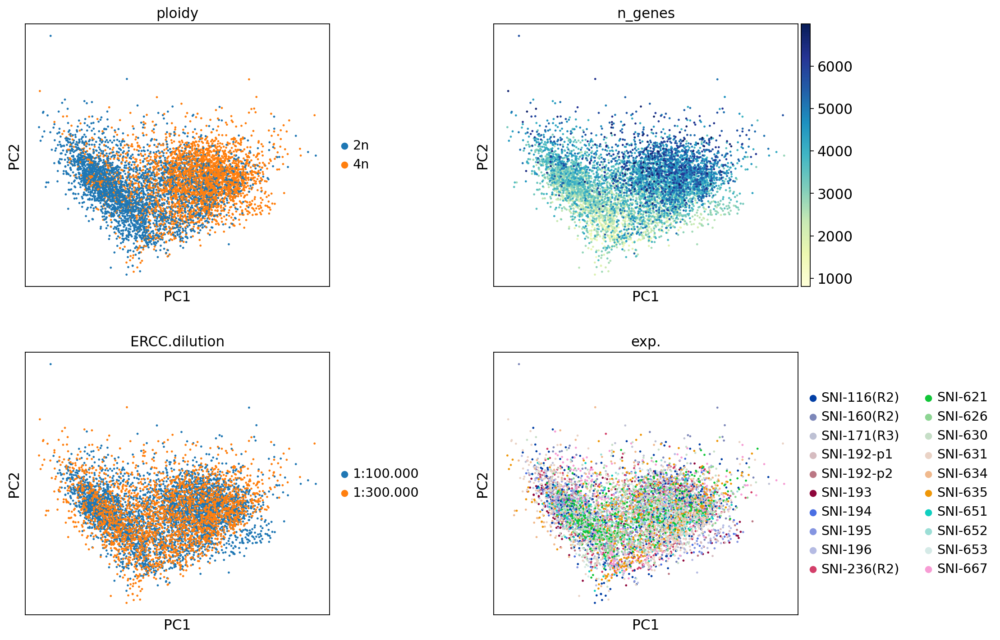

In [156]:
# PCA
sc.pl.pca_scatter(adata2, color=["ploidy","n_genes", "ERCC.dilution", "exp."],
                  ncols=2, wspace=0.4,
                  save= '_' + today +'_batch_corrected.pdf')

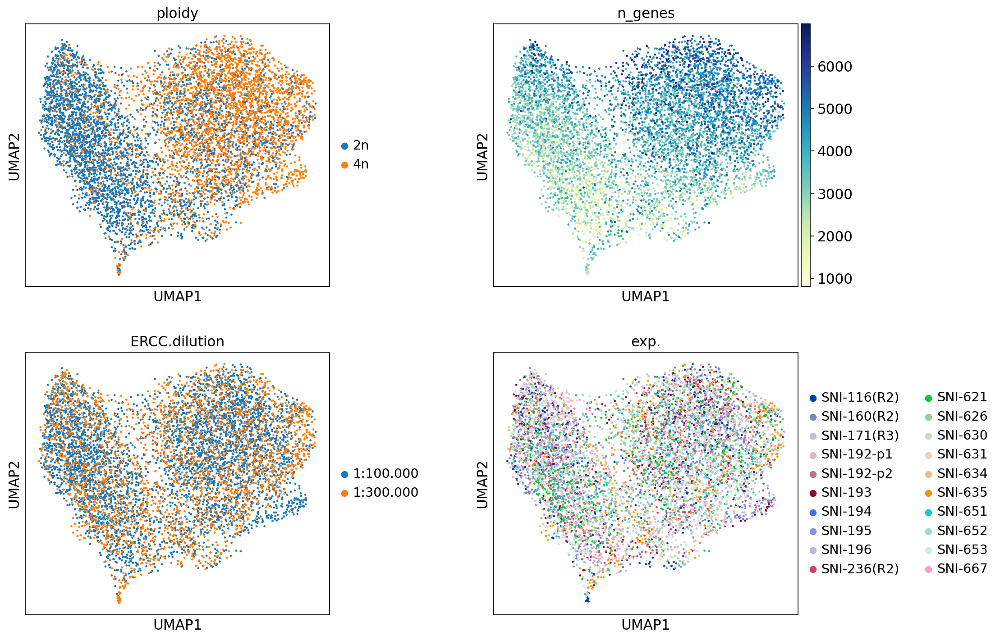

In [157]:
# UMAP
sc.pl.umap(adata2, color=[ "ploidy", "n_genes", "ERCC.dilution", "exp."],
           ncols=2, wspace=0.4, 
           save= '_' + today +'_batch_corrected.pdf')

In [158]:
# t-SNE
sc.tl.tsne(adata2, perplexity=50, n_pcs=10)

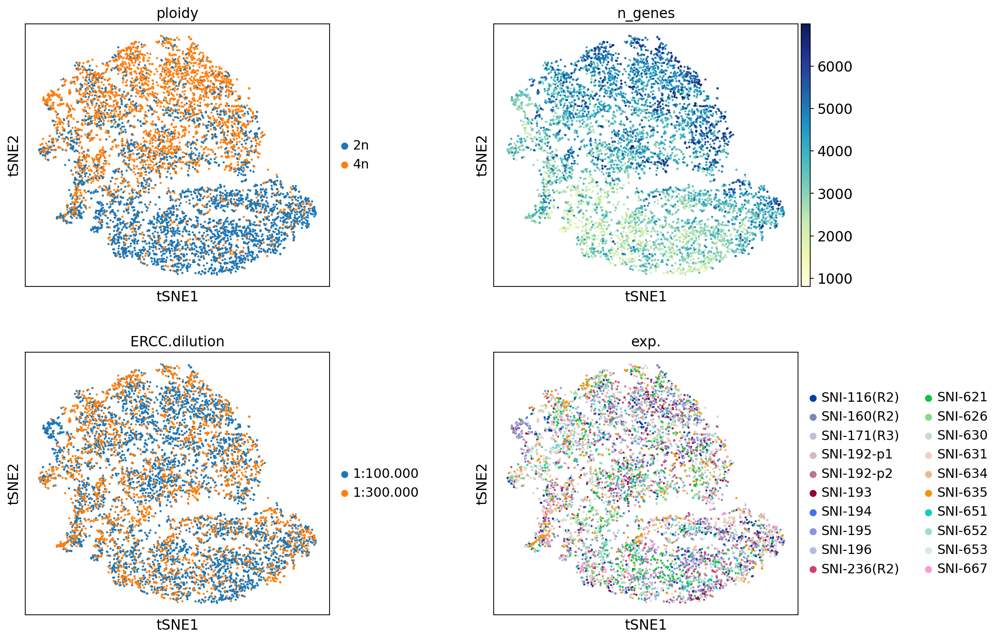

In [159]:
sc.pl.tsne(adata2, color=[ "ploidy", "n_genes", "ERCC.dilution", "exp."], ncols=2, wspace=0.4, 
           save='_' + today +'_batch_corrected.pdf')

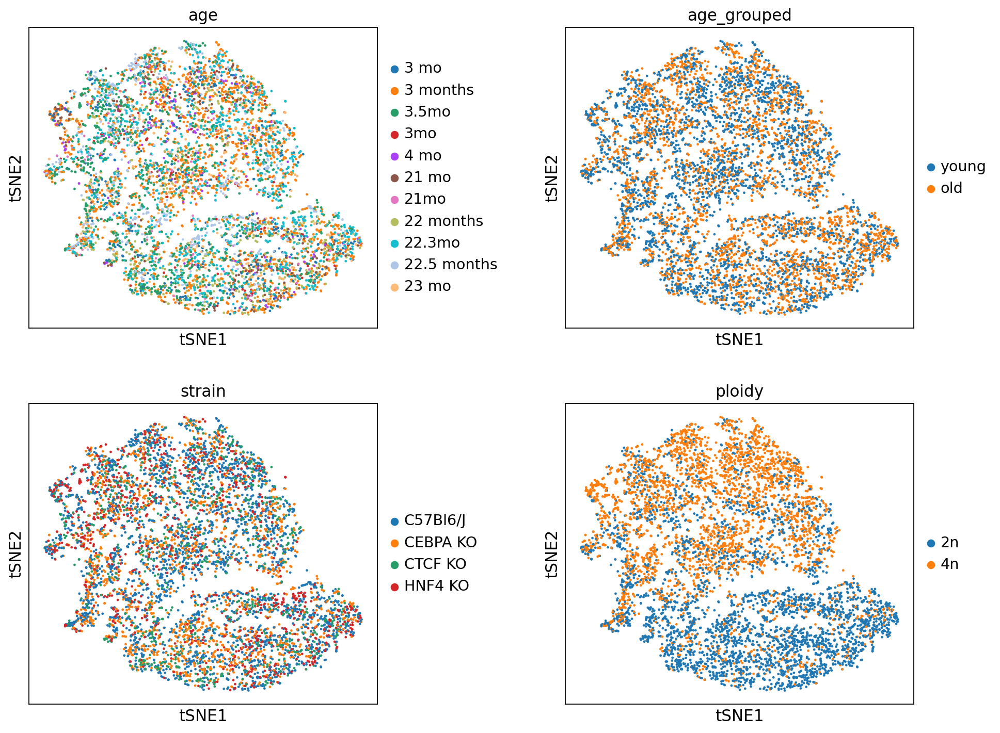

In [160]:
sc.pl.tsne(adata2, color=[ "age", 'age_grouped', 'strain', 'ploidy'], 
           ncols=2, wspace=0.4, save='_' + today +'_bio_batch_corrected.pdf')

In [161]:
adata2

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'exp._colors', 'log1p', 'pca', 'neighbors', 'umap', 'ploidy_colors', 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'strain_colors'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'distances', 'connectivities'

Save cell numbers per age and knock-out condition.

In [162]:
pd.crosstab(adata2.obs['age_grouped'], 
            adata2.obs['strain'], margins=True).to_csv(data_dir + today +'cells_per_condition.csv')

In [163]:
pd.crosstab(adata2.obs['age_grouped'], 
            adata2.obs['exp.'], margins=True).to_csv(data_dir + today +'cells_per_plate.csv')

In [164]:
pd.crosstab(adata2.obs['exp.'],adata2.obs['age_grouped'], 
             margins=True)

age_grouped,young,old,All
exp.,,,
SNI-116(R2),165,174,339
SNI-160(R2),152,186,338
SNI-171(R3),187,191,378
SNI-192-p1,167,151,318
SNI-192-p2,160,165,325
SNI-193,300,0,300
SNI-194,277,0,277
SNI-195,170,172,342
SNI-196,176,179,355


In [165]:
pd.crosstab(adata2.obs['age_grouped'], 
            adata2.obs['strain'], margins=True)

strain,C57Bl6/J,CEBPA KO,CTCF KO,HNF4 KO,All
age_grouped,,,,,
young,1733,828,495,518,3574
old,1175,844,504,508,3031
All,2908,1672,999,1026,6605


## Save adata for downstream analysis

In [166]:
adata2.write(data_dir + 'snRNAseq_mouse_hepatocytes_all_cells_filtered_TPM_mar21.h5ad')